<a href="https://colab.research.google.com/github/StudentID-210134263/AI_assessment/blob/trunk/data_preprocesing.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## This notebook would be around the intial data pre-processing and EDA in preparation for intial model model building


 **summary**:
- the dataset looks relatively balanced. There are 256 samples and there 90 cancer, 83 aneurysm, 83 and tumour samples. This means that when building our model we will not need the loss function 'focal_loss' since the dataset is not imbalanced (1).

-  I have also created a validation dataset containing 15 samples 5 from each category of results from CT scans. This is to ensure I do not overfit on either my training and testing data.

- as a starting point, I will use jpg images when training the models. However, it is clear that visualise the pixel array have a better contrast if we do some preprocessing and so if the performance of the model is poor that could be an option to improve performance of the model.

In [ ]:
# run this step beofore import to get package to visualise .dcm images
!pip install pydicom

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 19.3 MB/s eta 0:00:00


In [ ]:
# importing relevant libraries

# image storage on drive
from google.colab import drive
import os
import re

# viewing images
from PIL import Image
import pydicom as dicom
import cv2

# data extraction/manipulation
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
import tensorflow as tf

# data visualisation
import matplotlib.pyplot as plt


# drive.mount('/content/drive')

In [ ]:
inital_file_path = 'drive/MyDrive/ai_assessment/'

In [ ]:
# loading the data
data = pd.read_csv(inital_file_path+'ct_brain.csv')
data.head()

,dcm,jpg,type
0,/aneurysm/0.dcm,/aneurysm/0.jpg,aneurysm
1,/aneurysm/1.dcm,/aneurysm/1.jpg,aneurysm
2,/aneurysm/2.dcm,/aneurysm/2.jpg,aneurysm
3,/aneurysm/3.dcm,/aneurysm/3.jpg,aneurysm
4,/aneurysm/4.dcm,/aneurysm/4.jpg,aneurysm


In [ ]:
value_counts.sum()

type      canceraneurysmtumor
counts                    256
dtype: object

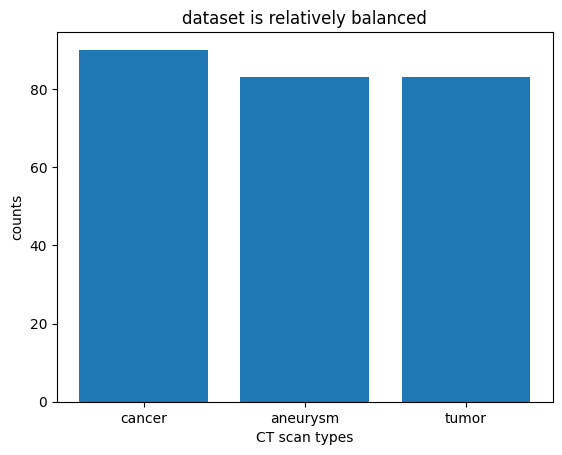

In [ ]:
value_counts = data['type'].value_counts().reset_index()
value_counts.rename(columns={'index': 'type', 'type': 'counts'}, inplace=True)
# value_counts
plt.bar(value_counts['type'], value_counts['counts'])
plt.title('dataset is relatively balanced')
plt.ylabel('counts')
plt.xlabel('CT scan types')
plt.show()

----FILE NAME aneurysm 0.jpg----


<Figure size 640x480 with 0 Axes>

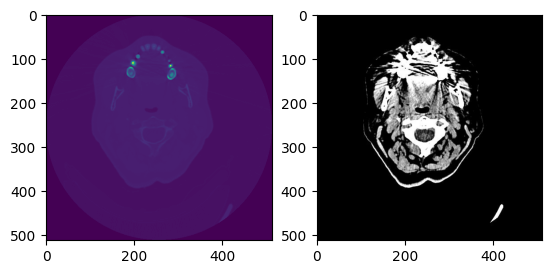

----FILE NAME aneurysm 1.jpg----


<Figure size 640x480 with 0 Axes>

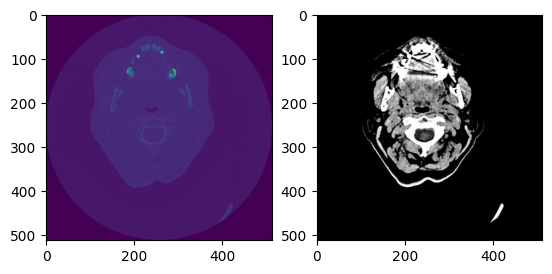

----FILE NAME aneurysm 2.jpg----


<Figure size 640x480 with 0 Axes>

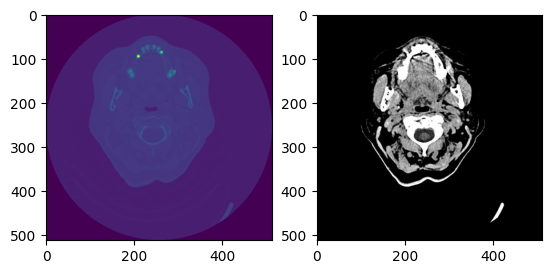

----FILE NAME aneurysm 3.jpg----


<Figure size 640x480 with 0 Axes>

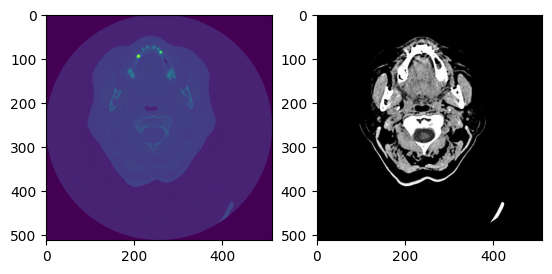

----FILE NAME aneurysm 4.jpg----


<Figure size 640x480 with 0 Axes>

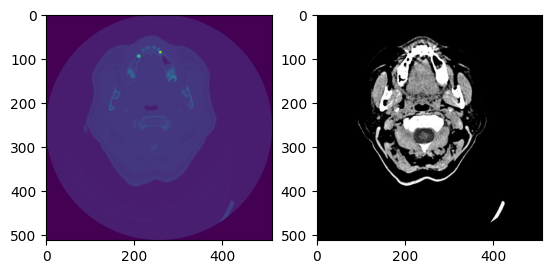

----FILE NAME aneurysm 5.jpg----


<Figure size 640x480 with 0 Axes>

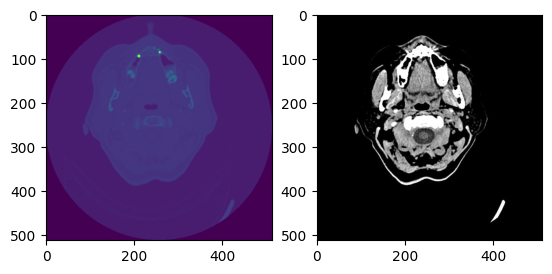

----FILE NAME aneurysm 6.jpg----


<Figure size 640x480 with 0 Axes>

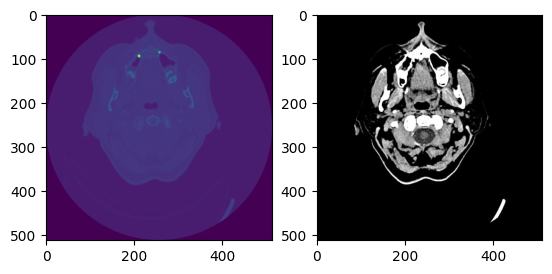

----FILE NAME aneurysm 7.jpg----


<Figure size 640x480 with 0 Axes>

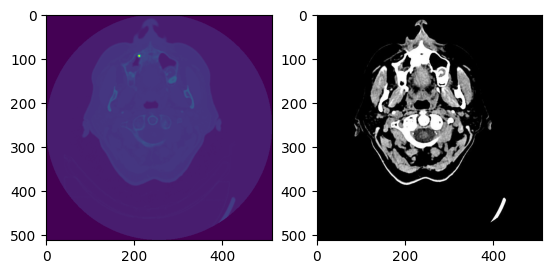

----FILE NAME aneurysm 8.jpg----


<Figure size 640x480 with 0 Axes>

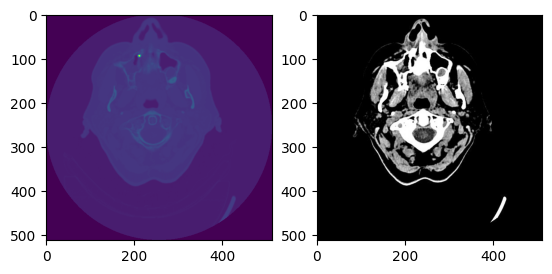

----FILE NAME aneurysm 9.jpg----


<Figure size 640x480 with 0 Axes>

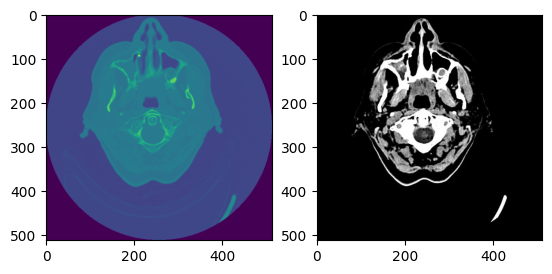

----FILE NAME aneurysm 10.jpg----


<Figure size 640x480 with 0 Axes>

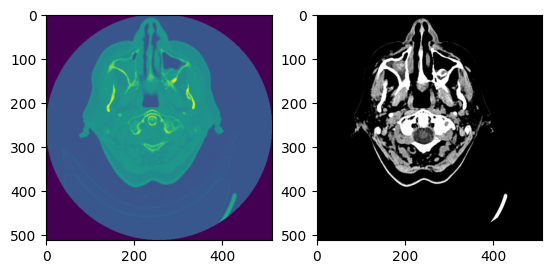

----FILE NAME aneurysm 11.jpg----


<Figure size 640x480 with 0 Axes>

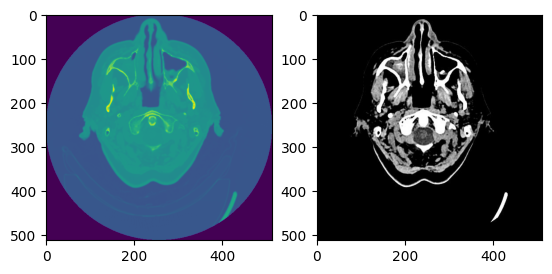

----FILE NAME aneurysm 12.jpg----


<Figure size 640x480 with 0 Axes>

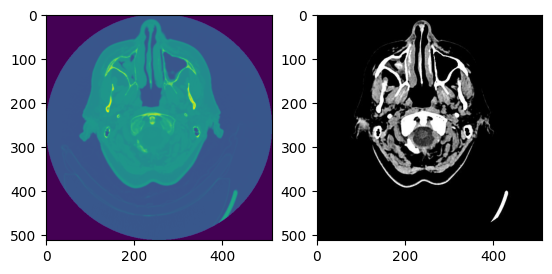

----FILE NAME aneurysm 13.jpg----


<Figure size 640x480 with 0 Axes>

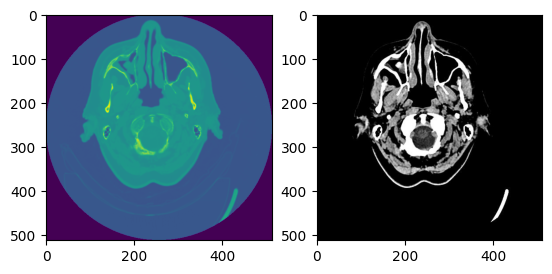

----FILE NAME aneurysm 14.jpg----


<Figure size 640x480 with 0 Axes>

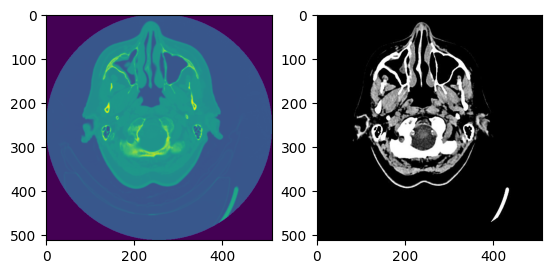

----FILE NAME aneurysm 15.jpg----


<Figure size 640x480 with 0 Axes>

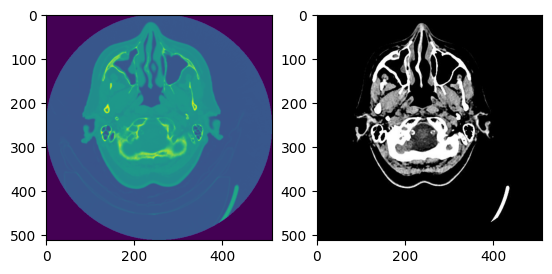

----FILE NAME aneurysm 16.jpg----


<Figure size 640x480 with 0 Axes>

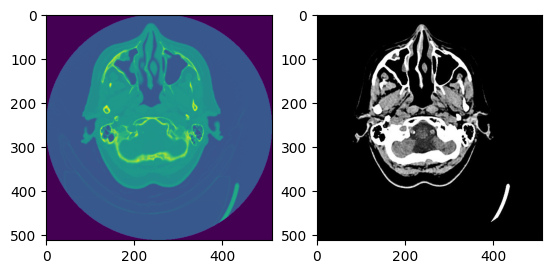

----FILE NAME aneurysm 17.jpg----


<Figure size 640x480 with 0 Axes>

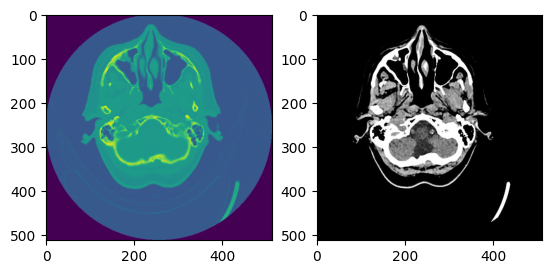

----FILE NAME aneurysm 18.jpg----


<Figure size 640x480 with 0 Axes>

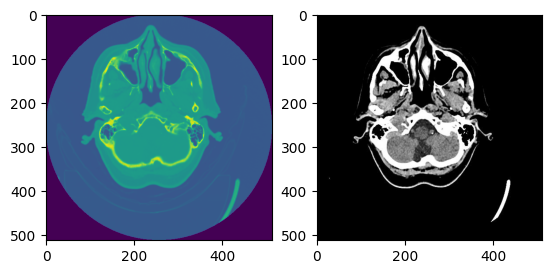

----FILE NAME aneurysm 20.jpg----


<Figure size 640x480 with 0 Axes>

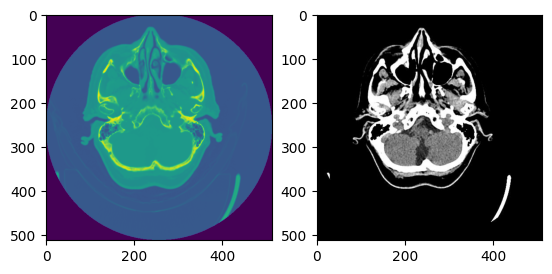

----FILE NAME aneurysm 21.jpg----


<Figure size 640x480 with 0 Axes>

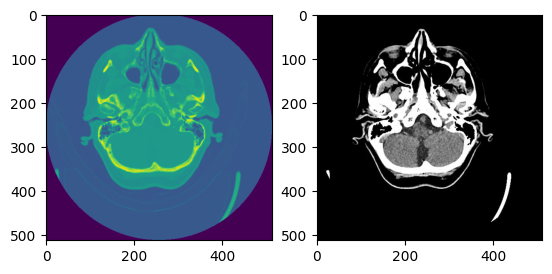

----FILE NAME aneurysm 22.jpg----


<Figure size 640x480 with 0 Axes>

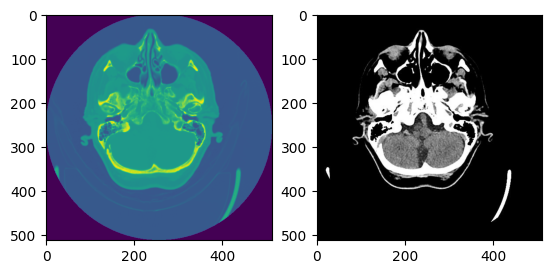

----FILE NAME aneurysm 23.jpg----


<Figure size 640x480 with 0 Axes>

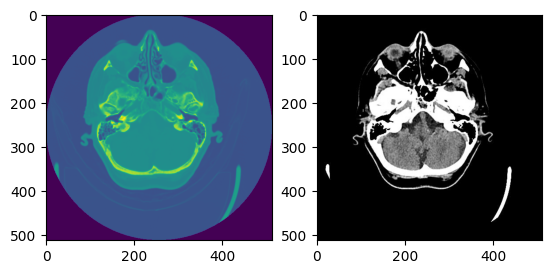

----FILE NAME aneurysm 24.jpg----


<Figure size 640x480 with 0 Axes>

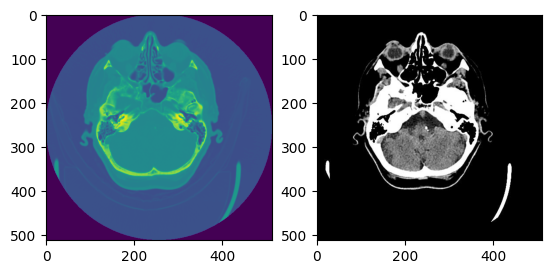

----FILE NAME aneurysm 25.jpg----


<Figure size 640x480 with 0 Axes>

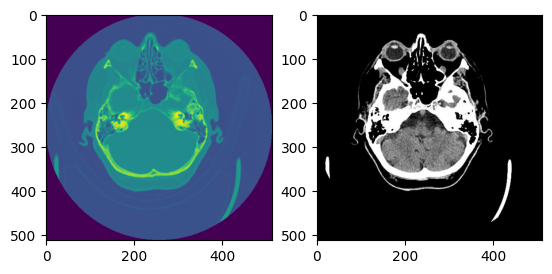

----FILE NAME aneurysm 26.jpg----


<Figure size 640x480 with 0 Axes>

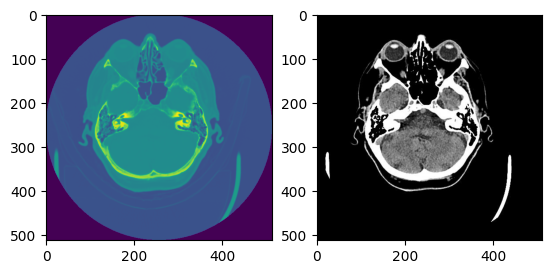

----FILE NAME aneurysm 27.jpg----


<Figure size 640x480 with 0 Axes>

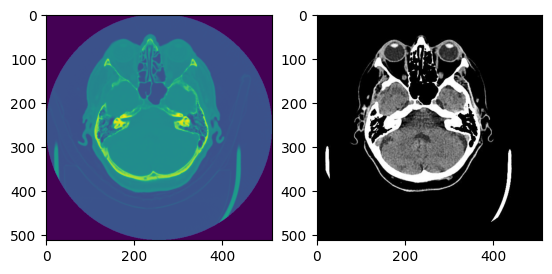

----FILE NAME aneurysm 28.jpg----


<Figure size 640x480 with 0 Axes>

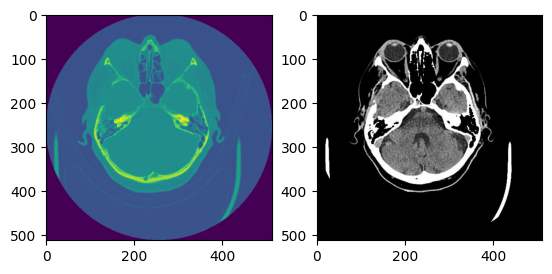

----FILE NAME aneurysm 29.jpg----


<Figure size 640x480 with 0 Axes>

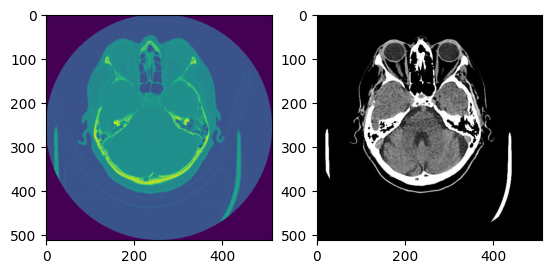

----FILE NAME aneurysm 30.jpg----


<Figure size 640x480 with 0 Axes>

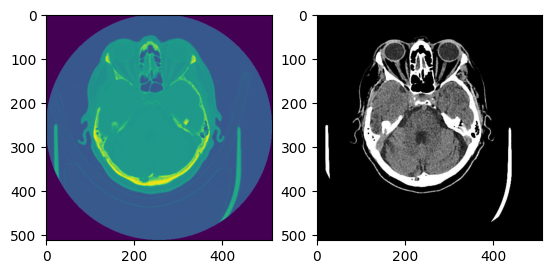

----FILE NAME aneurysm 31.jpg----


<Figure size 640x480 with 0 Axes>

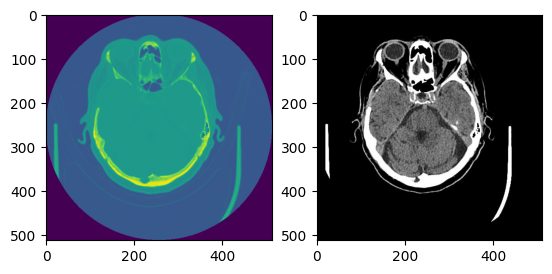

----FILE NAME aneurysm 32.jpg----


<Figure size 640x480 with 0 Axes>

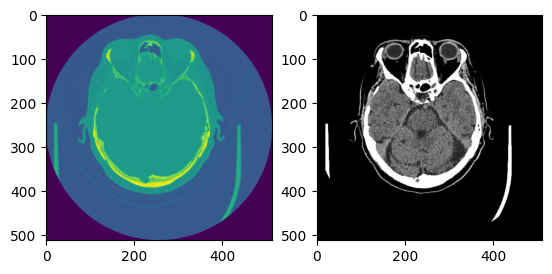

----FILE NAME aneurysm 33.jpg----


<Figure size 640x480 with 0 Axes>

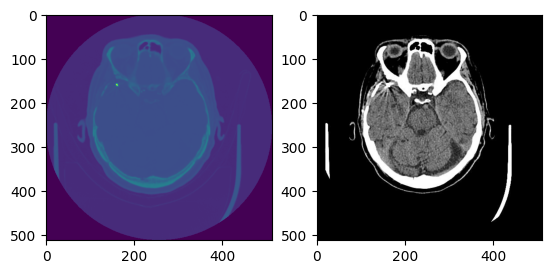

----FILE NAME aneurysm 34.jpg----


<Figure size 640x480 with 0 Axes>

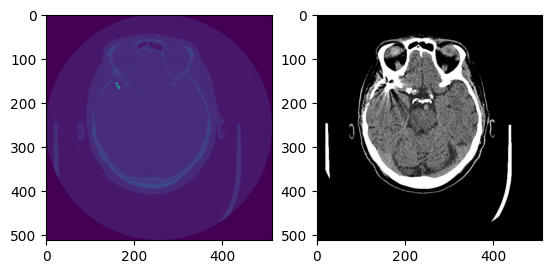

----FILE NAME aneurysm 35.jpg----


<Figure size 640x480 with 0 Axes>

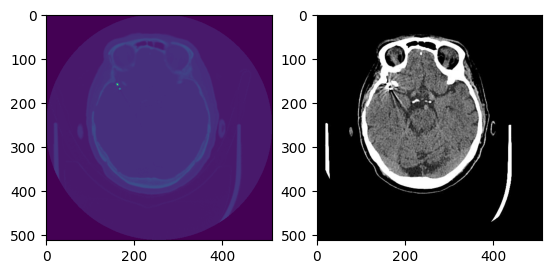

----FILE NAME aneurysm 36.jpg----


<Figure size 640x480 with 0 Axes>

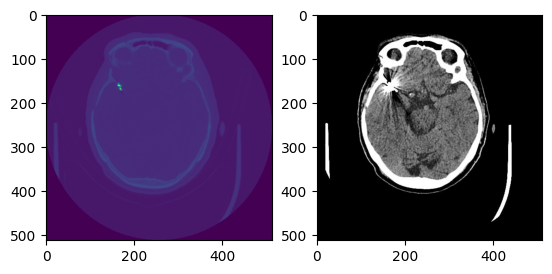

----FILE NAME aneurysm 37.jpg----


<Figure size 640x480 with 0 Axes>

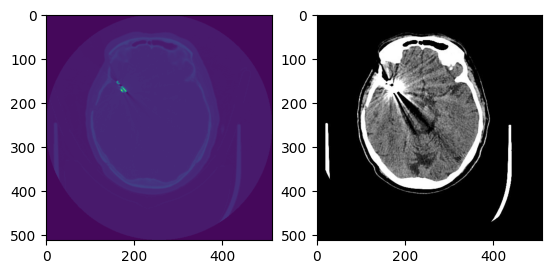

----FILE NAME aneurysm 38.jpg----


<Figure size 640x480 with 0 Axes>

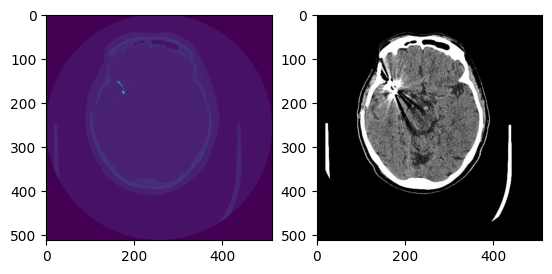

----FILE NAME aneurysm 39.jpg----


<Figure size 640x480 with 0 Axes>

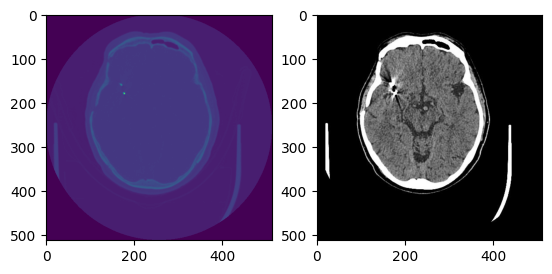

----FILE NAME aneurysm 40.jpg----


<Figure size 640x480 with 0 Axes>

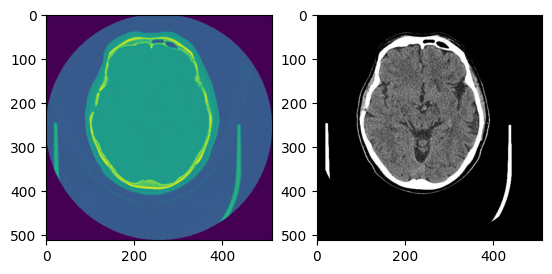

----FILE NAME aneurysm 41.jpg----


<Figure size 640x480 with 0 Axes>

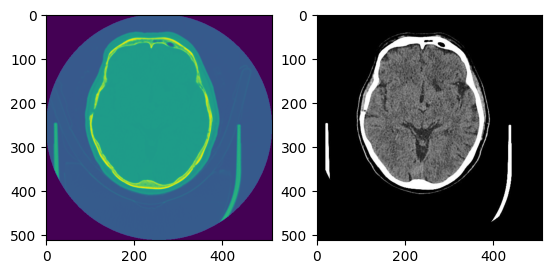

----FILE NAME aneurysm 42.jpg----


<Figure size 640x480 with 0 Axes>

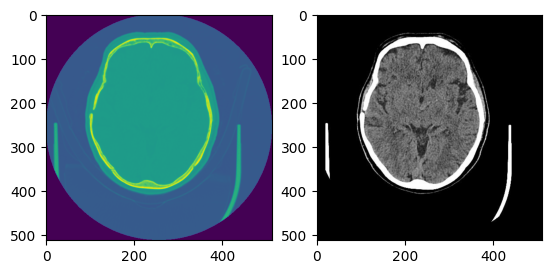

----FILE NAME aneurysm 43.jpg----


<Figure size 640x480 with 0 Axes>

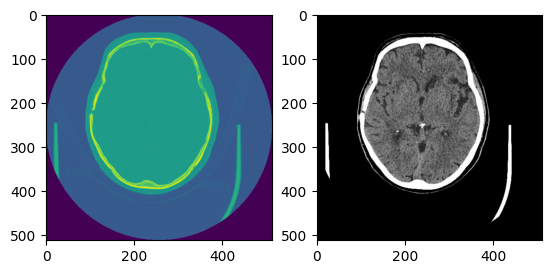

----FILE NAME aneurysm 44.jpg----


<Figure size 640x480 with 0 Axes>

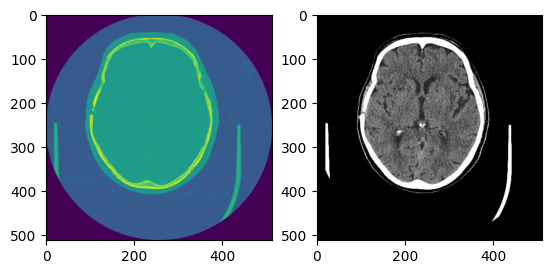

----FILE NAME aneurysm 45.jpg----


<Figure size 640x480 with 0 Axes>

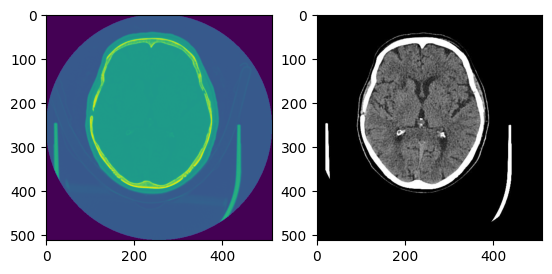

----FILE NAME aneurysm 46.jpg----


<Figure size 640x480 with 0 Axes>

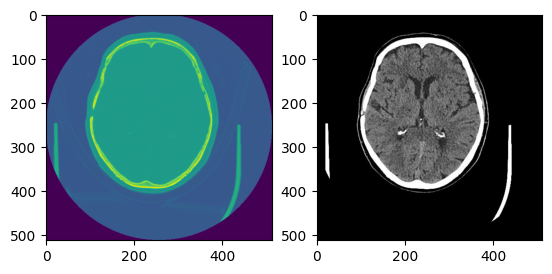

----FILE NAME aneurysm 47.jpg----


<Figure size 640x480 with 0 Axes>

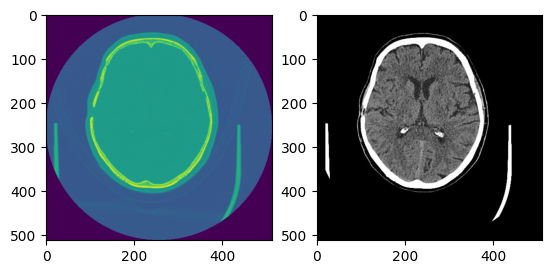

----FILE NAME aneurysm 48.jpg----


<Figure size 640x480 with 0 Axes>

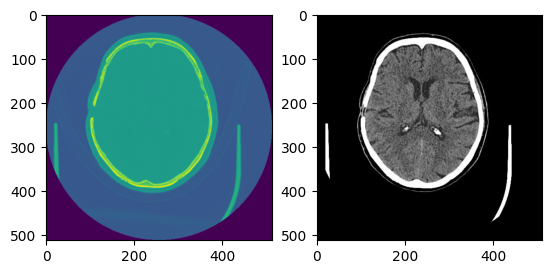

----FILE NAME aneurysm 49.jpg----


<Figure size 640x480 with 0 Axes>

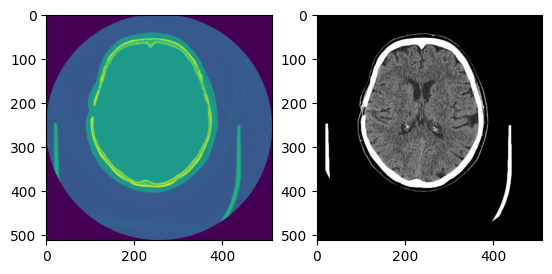

----FILE NAME aneurysm 50.jpg----


<Figure size 640x480 with 0 Axes>

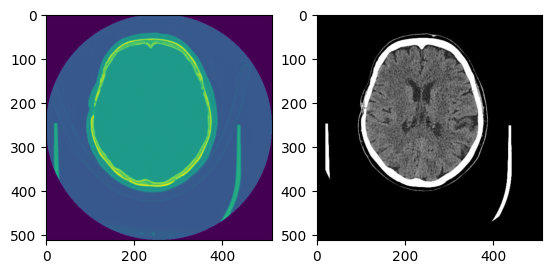

----FILE NAME aneurysm 51.jpg----


<Figure size 640x480 with 0 Axes>

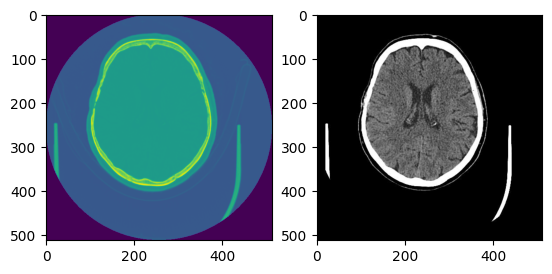

----FILE NAME aneurysm 52.jpg----


<Figure size 640x480 with 0 Axes>

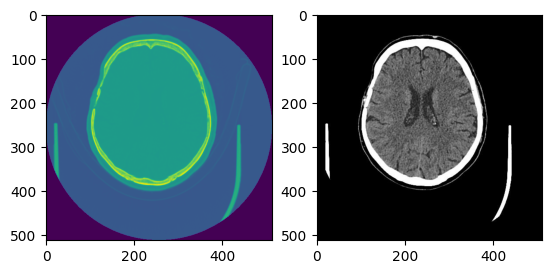

----FILE NAME aneurysm 53.jpg----


<Figure size 640x480 with 0 Axes>

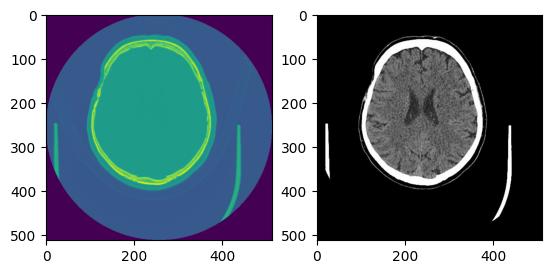

----FILE NAME aneurysm 54.jpg----


<Figure size 640x480 with 0 Axes>

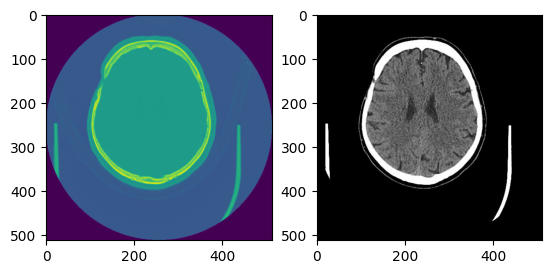

----FILE NAME aneurysm 55.jpg----


<Figure size 640x480 with 0 Axes>

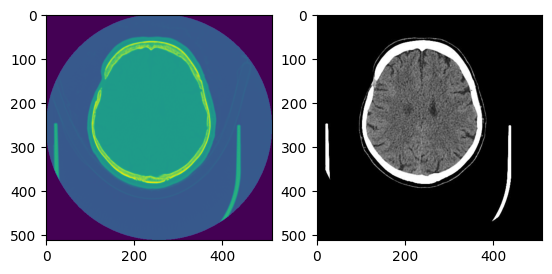

----FILE NAME aneurysm 56.jpg----


<Figure size 640x480 with 0 Axes>

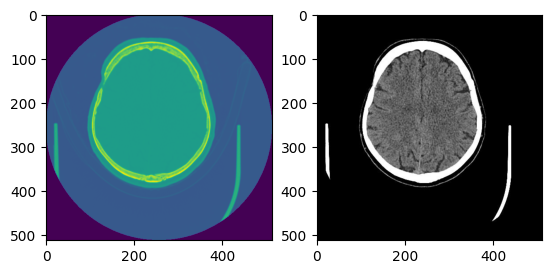

----FILE NAME aneurysm 57.jpg----


<Figure size 640x480 with 0 Axes>

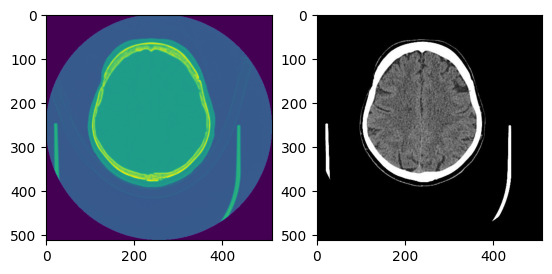

----FILE NAME aneurysm 58.jpg----


<Figure size 640x480 with 0 Axes>

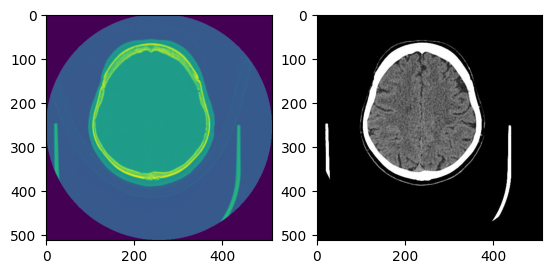

----FILE NAME aneurysm 59.jpg----


<Figure size 640x480 with 0 Axes>

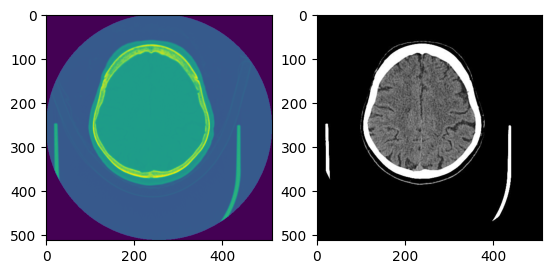

----FILE NAME aneurysm 60.jpg----


<Figure size 640x480 with 0 Axes>

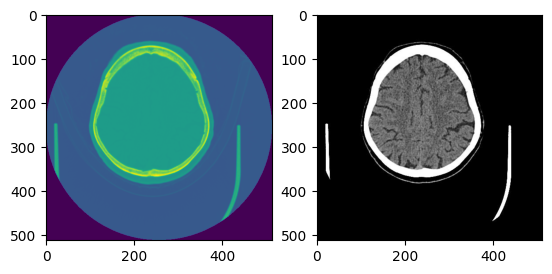

----FILE NAME aneurysm 61.jpg----


<Figure size 640x480 with 0 Axes>

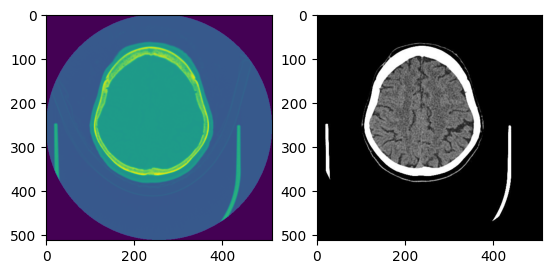

----FILE NAME aneurysm 62.jpg----


<Figure size 640x480 with 0 Axes>

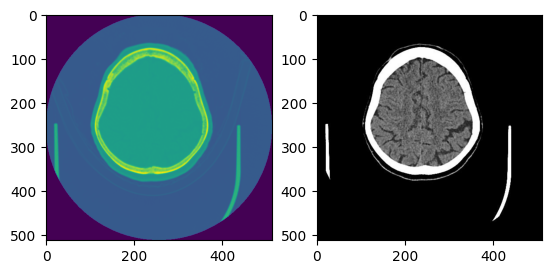

----FILE NAME aneurysm 63.jpg----


<Figure size 640x480 with 0 Axes>

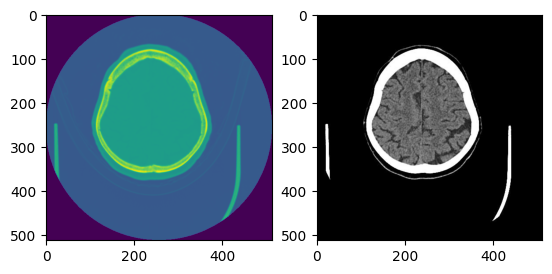

----FILE NAME aneurysm 64.jpg----


<Figure size 640x480 with 0 Axes>

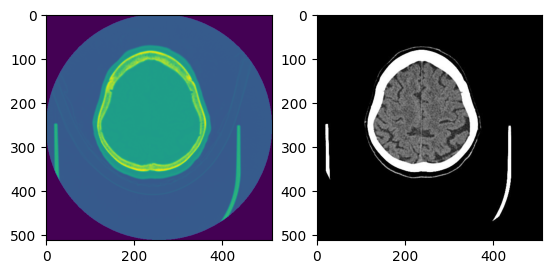

----FILE NAME aneurysm 65.jpg----


<Figure size 640x480 with 0 Axes>

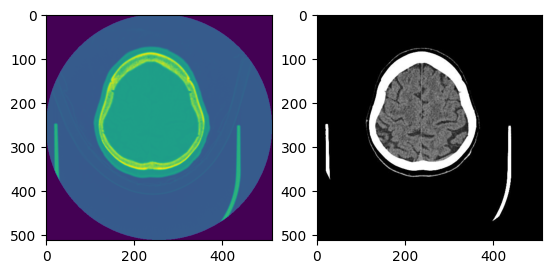

----FILE NAME aneurysm 66.jpg----


<Figure size 640x480 with 0 Axes>

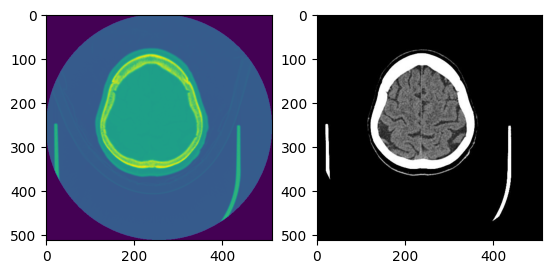

----FILE NAME aneurysm 67.jpg----


<Figure size 640x480 with 0 Axes>

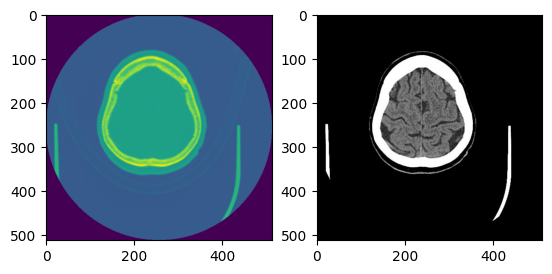

----FILE NAME aneurysm 68.jpg----


<Figure size 640x480 with 0 Axes>

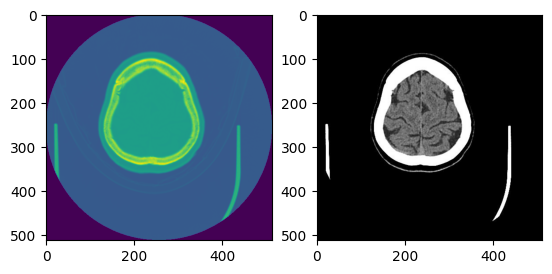

----FILE NAME aneurysm 69.jpg----


<Figure size 640x480 with 0 Axes>

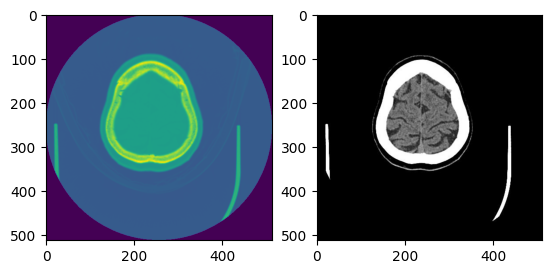

----FILE NAME aneurysm 70.jpg----


<Figure size 640x480 with 0 Axes>

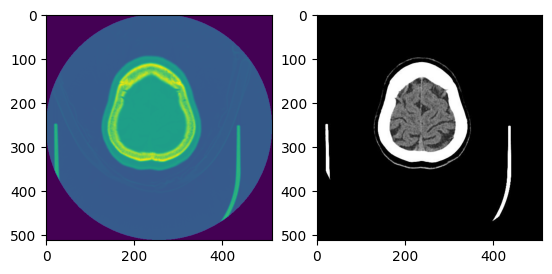

----FILE NAME aneurysm 71.jpg----


<Figure size 640x480 with 0 Axes>

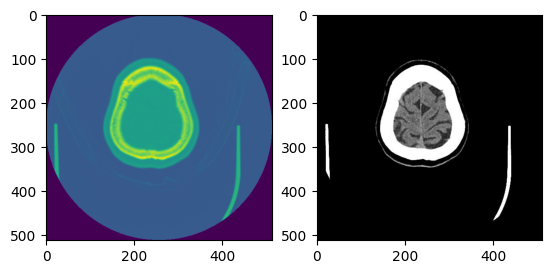

----FILE NAME aneurysm 72.jpg----


<Figure size 640x480 with 0 Axes>

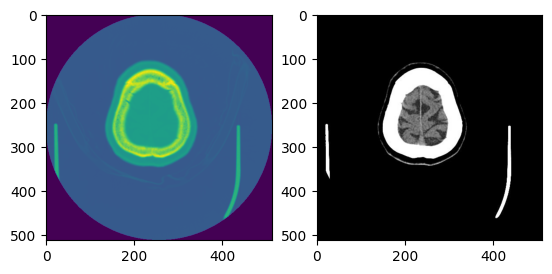

----FILE NAME aneurysm 73.jpg----


<Figure size 640x480 with 0 Axes>

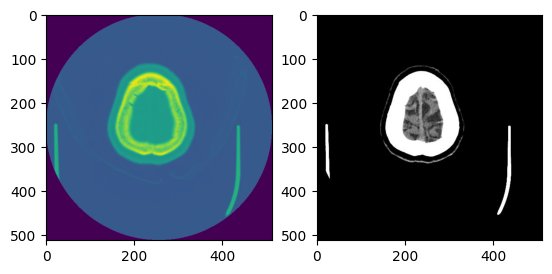

----FILE NAME aneurysm 74.jpg----


<Figure size 640x480 with 0 Axes>

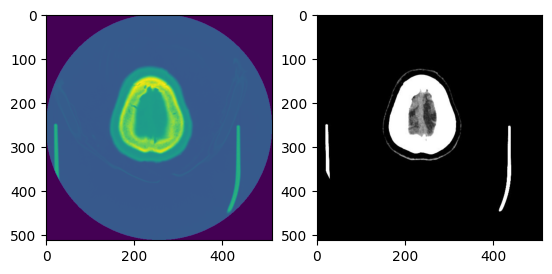

----FILE NAME aneurysm 75.jpg----


<Figure size 640x480 with 0 Axes>

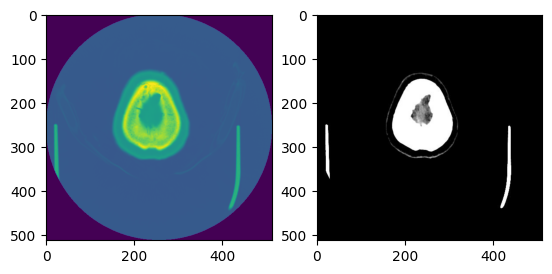

----FILE NAME aneurysm 76.jpg----


<Figure size 640x480 with 0 Axes>

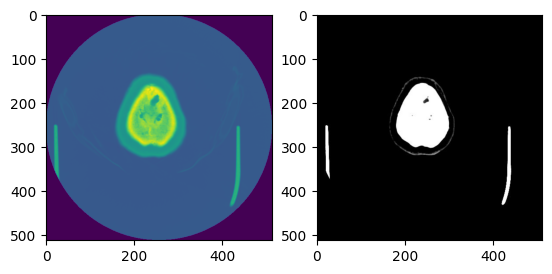

----FILE NAME aneurysm 77.jpg----


<Figure size 640x480 with 0 Axes>

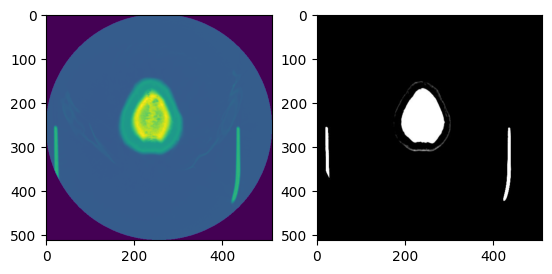

----FILE NAME aneurysm 78.jpg----


<Figure size 640x480 with 0 Axes>

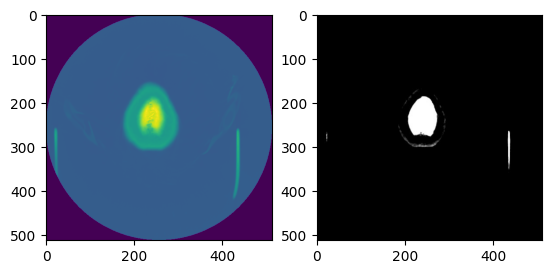

----FILE NAME aneurysm 79.jpg----


<Figure size 640x480 with 0 Axes>

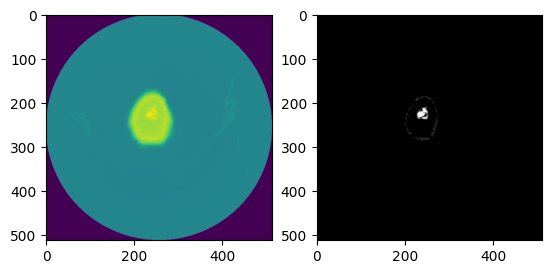

----FILE NAME aneurysm 80.jpg----


<Figure size 640x480 with 0 Axes>

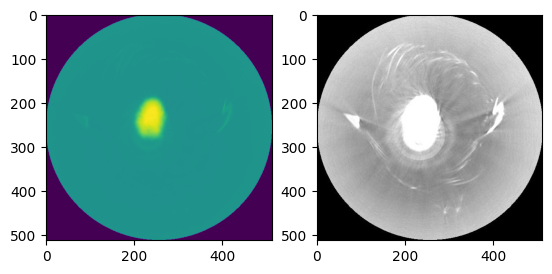

----FILE NAME aneurysm 81.jpg----


<Figure size 640x480 with 0 Axes>

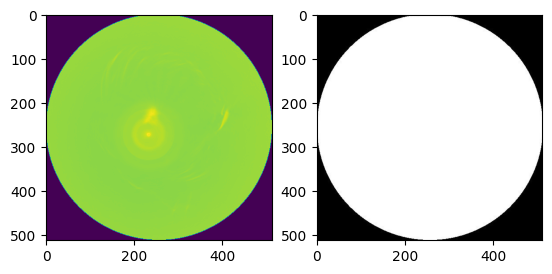

----FILE NAME aneurysm 82.jpg----


<Figure size 640x480 with 0 Axes>

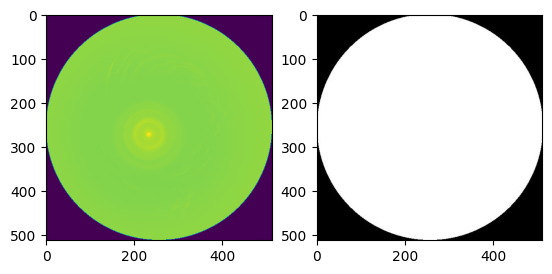

----FILE NAME aneurysm 83.jpg----


<Figure size 640x480 with 0 Axes>

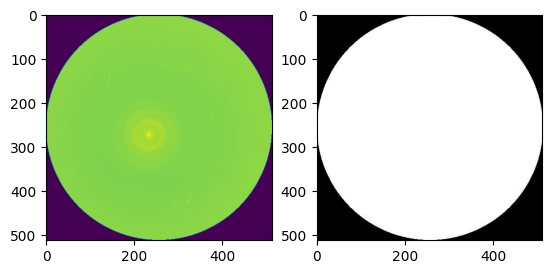

----FILE NAME tumor 0.jpg----


<Figure size 640x480 with 0 Axes>

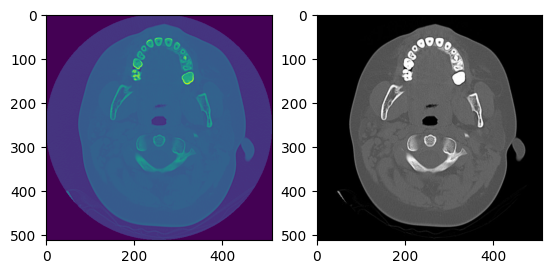

----FILE NAME tumor 1.jpg----


<Figure size 640x480 with 0 Axes>

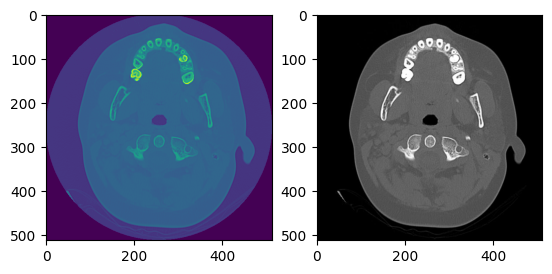

----FILE NAME tumor 2.jpg----


<Figure size 640x480 with 0 Axes>

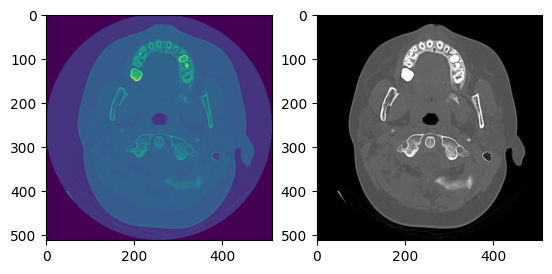

----FILE NAME tumor 3.jpg----


<Figure size 640x480 with 0 Axes>

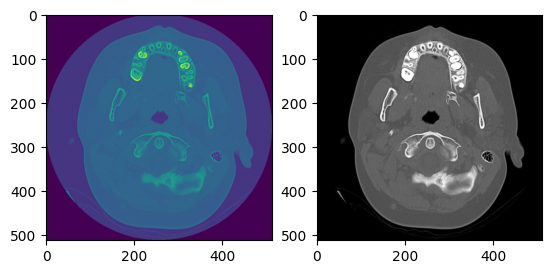

----FILE NAME tumor 4.jpg----


<Figure size 640x480 with 0 Axes>

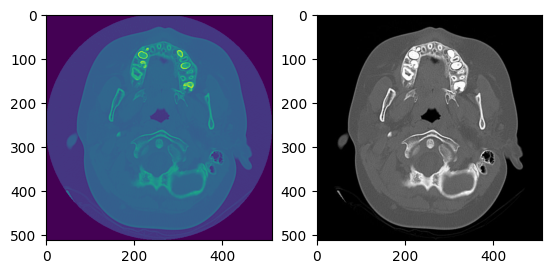

----FILE NAME tumor 5.jpg----


<Figure size 640x480 with 0 Axes>

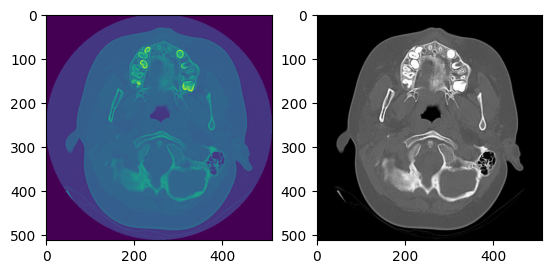

----FILE NAME tumor 6.jpg----


<Figure size 640x480 with 0 Axes>

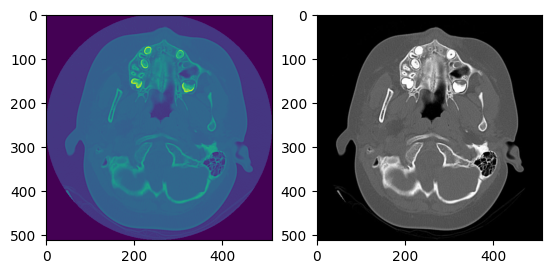

----FILE NAME tumor 7.jpg----


<Figure size 640x480 with 0 Axes>

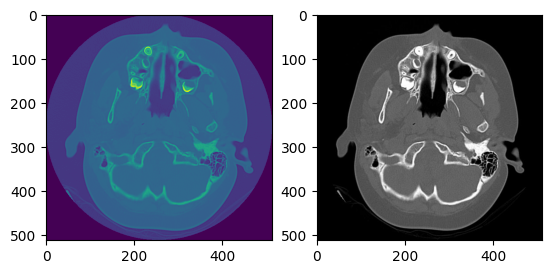

----FILE NAME tumor 8.jpg----


<Figure size 640x480 with 0 Axes>

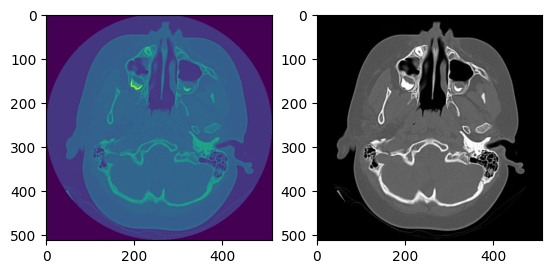

----FILE NAME tumor 9.jpg----


<Figure size 640x480 with 0 Axes>

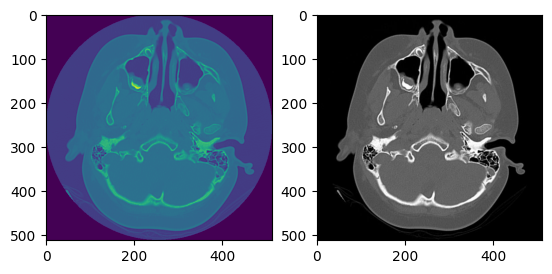

----FILE NAME tumor 10.jpg----


<Figure size 640x480 with 0 Axes>

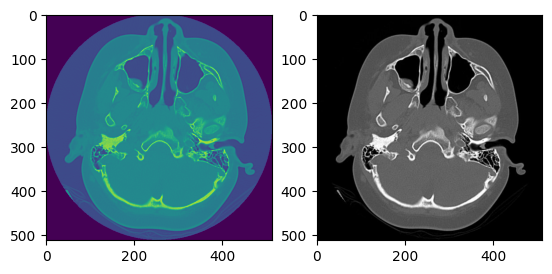

----FILE NAME tumor 11.jpg----


<Figure size 640x480 with 0 Axes>

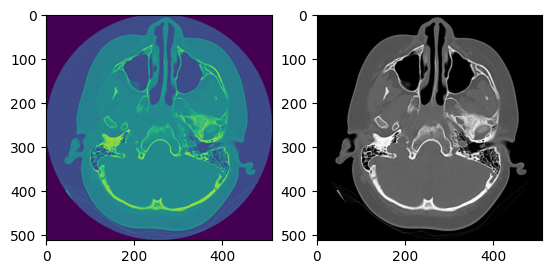

----FILE NAME tumor 12.jpg----


<Figure size 640x480 with 0 Axes>

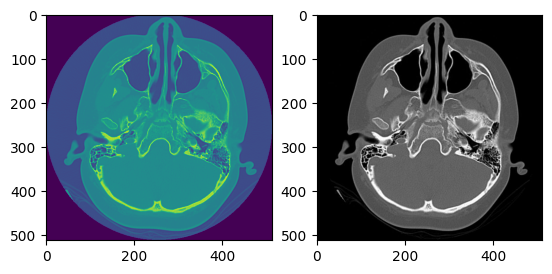

----FILE NAME tumor 13.jpg----


<Figure size 640x480 with 0 Axes>

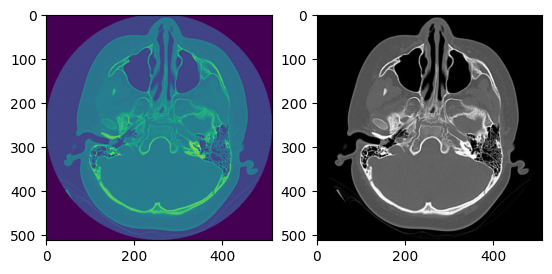

----FILE NAME tumor 14.jpg----


<Figure size 640x480 with 0 Axes>

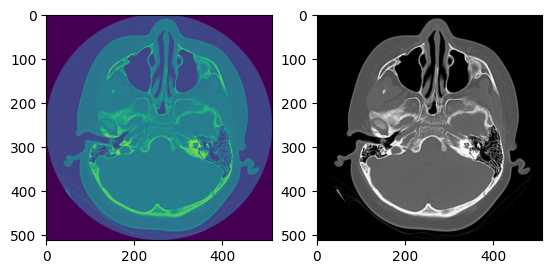

----FILE NAME tumor 15.jpg----


<Figure size 640x480 with 0 Axes>

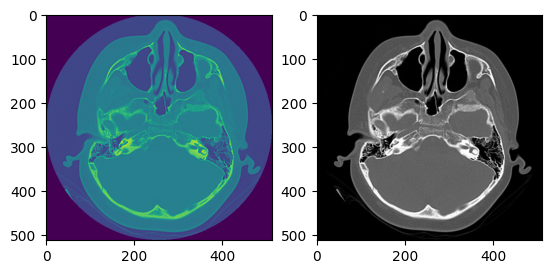

----FILE NAME tumor 16.jpg----


<Figure size 640x480 with 0 Axes>

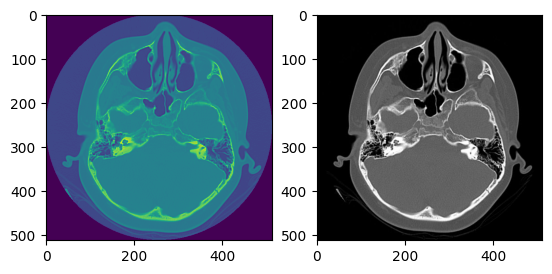

----FILE NAME tumor 17.jpg----


<Figure size 640x480 with 0 Axes>

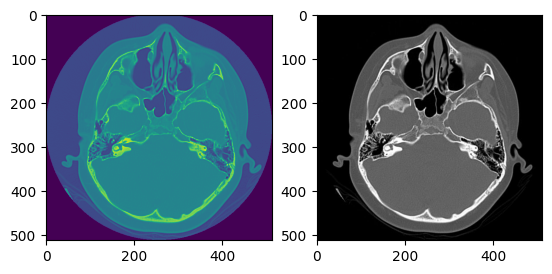

----FILE NAME tumor 18.jpg----


<Figure size 640x480 with 0 Axes>

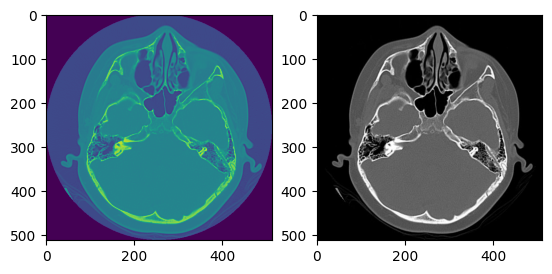

----FILE NAME tumor 20.jpg----


<Figure size 640x480 with 0 Axes>

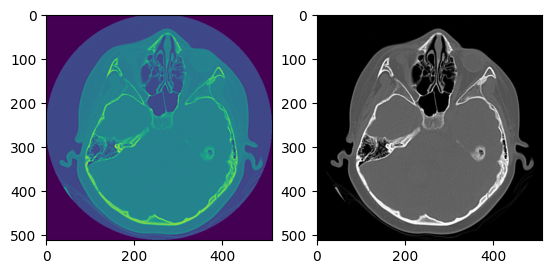

----FILE NAME tumor 21.jpg----


<Figure size 640x480 with 0 Axes>

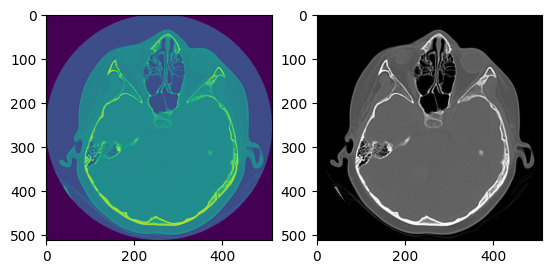

----FILE NAME tumor 22.jpg----


<Figure size 640x480 with 0 Axes>

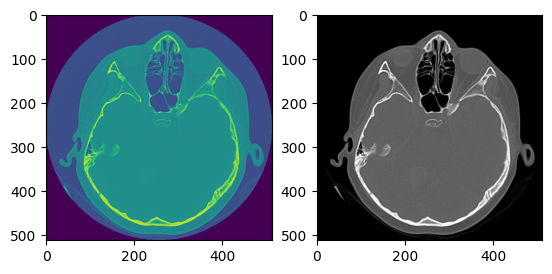

----FILE NAME tumor 23.jpg----


<Figure size 640x480 with 0 Axes>

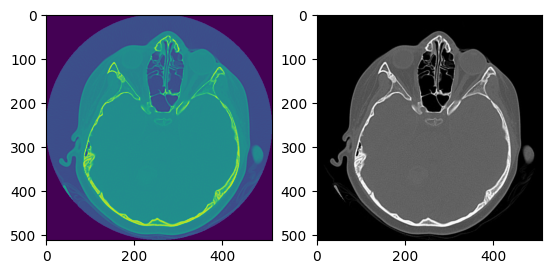

----FILE NAME tumor 24.jpg----


<Figure size 640x480 with 0 Axes>

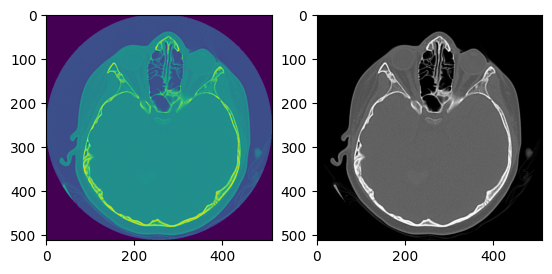

----FILE NAME tumor 25.jpg----


<Figure size 640x480 with 0 Axes>

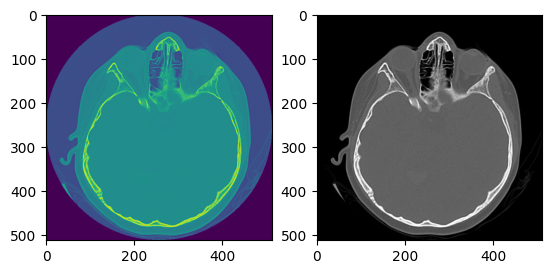

----FILE NAME tumor 26.jpg----


<Figure size 640x480 with 0 Axes>

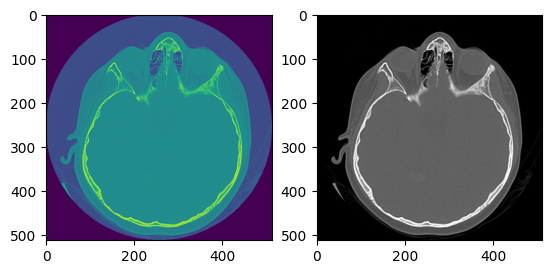

----FILE NAME tumor 27.jpg----


<Figure size 640x480 with 0 Axes>

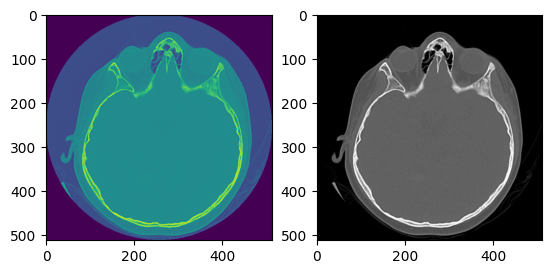

----FILE NAME tumor 28.jpg----


<Figure size 640x480 with 0 Axes>

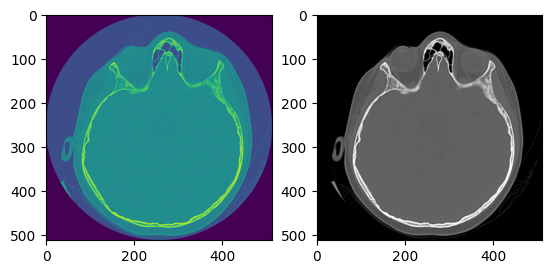

----FILE NAME tumor 29.jpg----


<Figure size 640x480 with 0 Axes>

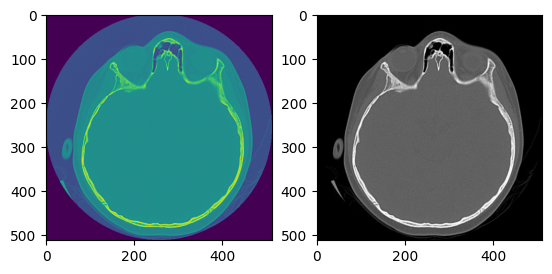

----FILE NAME tumor 30.jpg----


<Figure size 640x480 with 0 Axes>

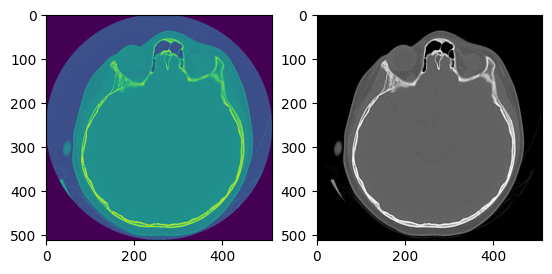

----FILE NAME tumor 31.jpg----


<Figure size 640x480 with 0 Axes>

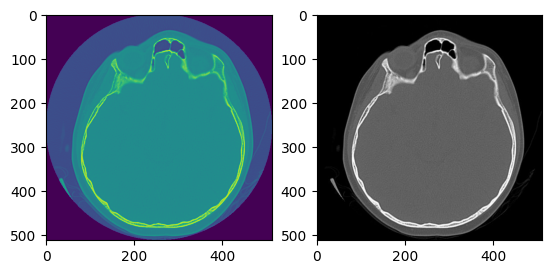

----FILE NAME tumor 32.jpg----


<Figure size 640x480 with 0 Axes>

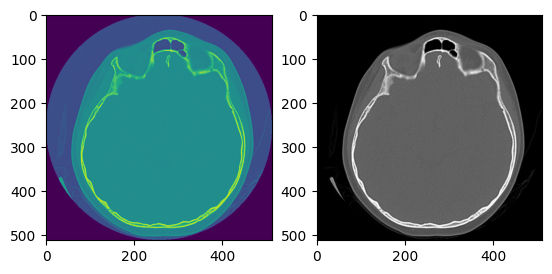

----FILE NAME tumor 33.jpg----


<Figure size 640x480 with 0 Axes>

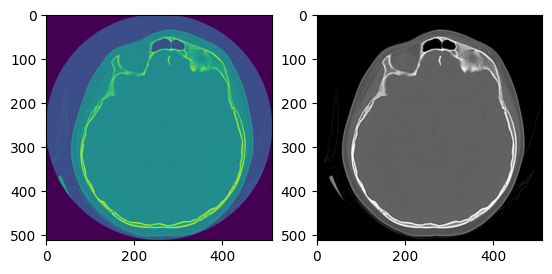

----FILE NAME tumor 34.jpg----


<Figure size 640x480 with 0 Axes>

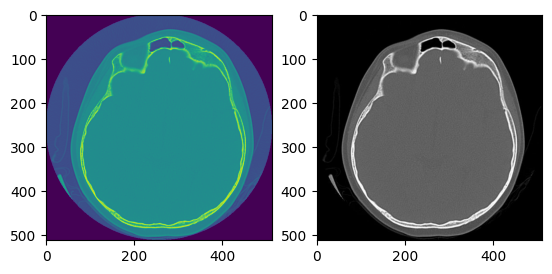

----FILE NAME tumor 35.jpg----


<Figure size 640x480 with 0 Axes>

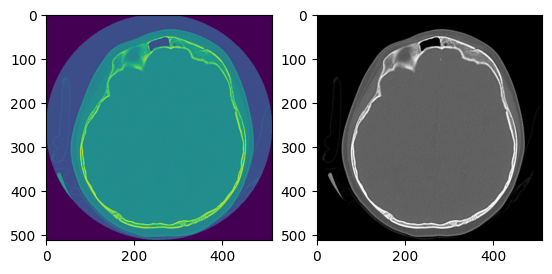

----FILE NAME tumor 36.jpg----


<Figure size 640x480 with 0 Axes>

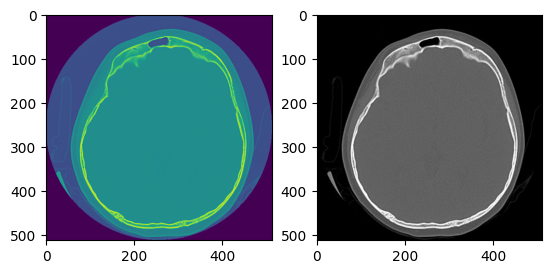

----FILE NAME tumor 37.jpg----


<Figure size 640x480 with 0 Axes>

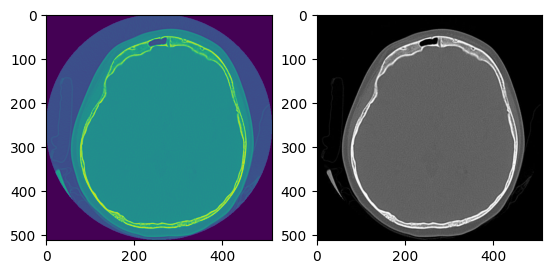

----FILE NAME tumor 38.jpg----


<Figure size 640x480 with 0 Axes>

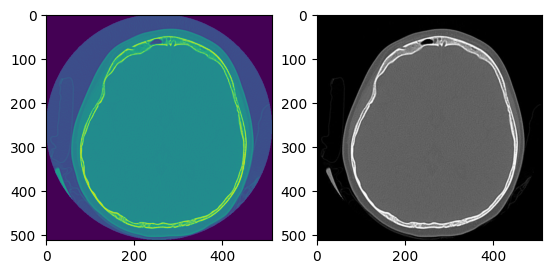

----FILE NAME tumor 39.jpg----


<Figure size 640x480 with 0 Axes>

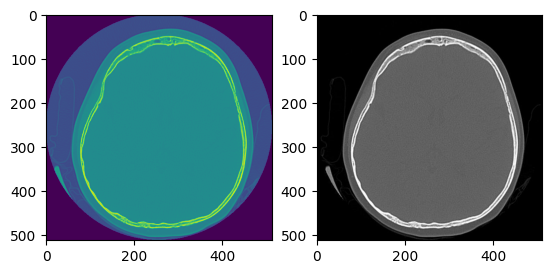

----FILE NAME tumor 40.jpg----


<Figure size 640x480 with 0 Axes>

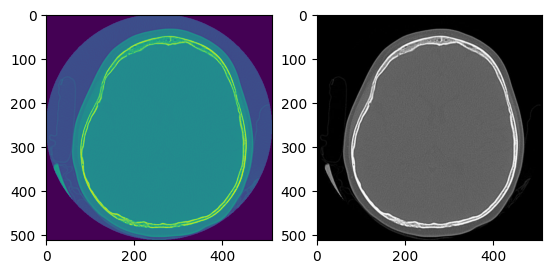

----FILE NAME tumor 41.jpg----


<Figure size 640x480 with 0 Axes>

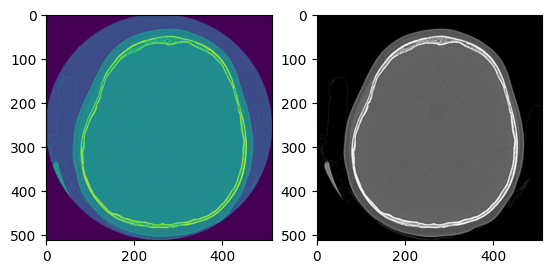

----FILE NAME tumor 42.jpg----


<Figure size 640x480 with 0 Axes>

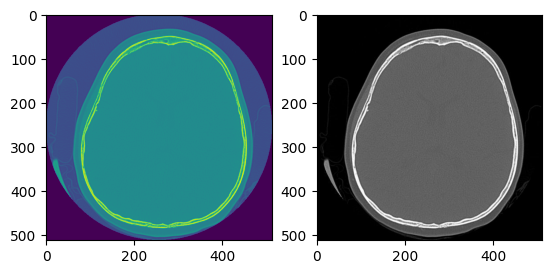

----FILE NAME tumor 43.jpg----


<Figure size 640x480 with 0 Axes>

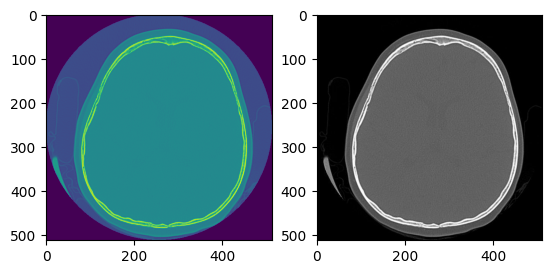

----FILE NAME tumor 44.jpg----


<Figure size 640x480 with 0 Axes>

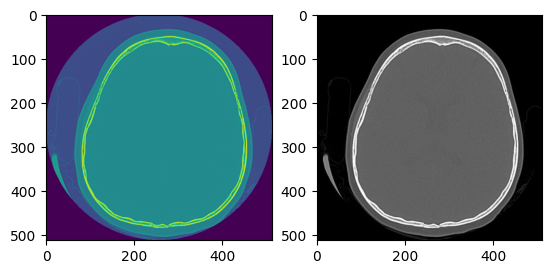

----FILE NAME tumor 45.jpg----


<Figure size 640x480 with 0 Axes>

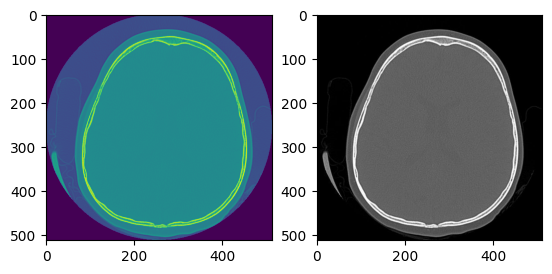

----FILE NAME tumor 46.jpg----


<Figure size 640x480 with 0 Axes>

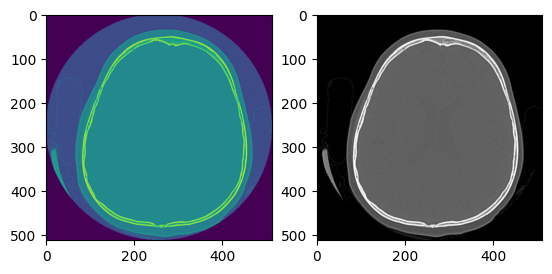

----FILE NAME tumor 47.jpg----


<Figure size 640x480 with 0 Axes>

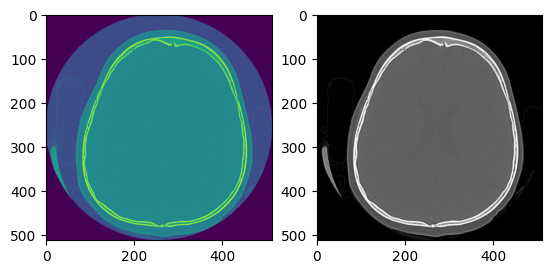

----FILE NAME tumor 48.jpg----


<Figure size 640x480 with 0 Axes>

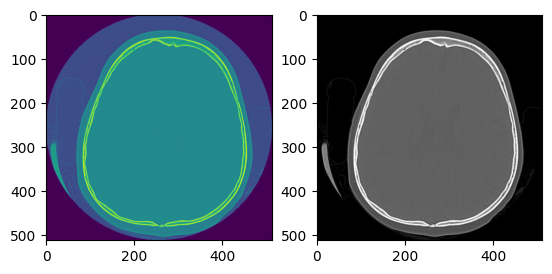

----FILE NAME tumor 49.jpg----


<Figure size 640x480 with 0 Axes>

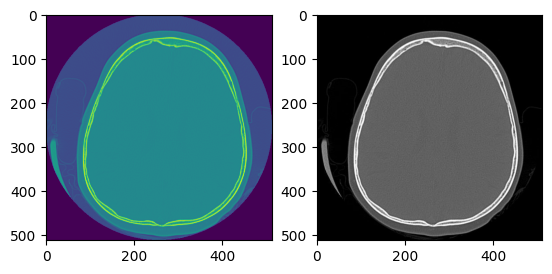

----FILE NAME tumor 50.jpg----


<Figure size 640x480 with 0 Axes>

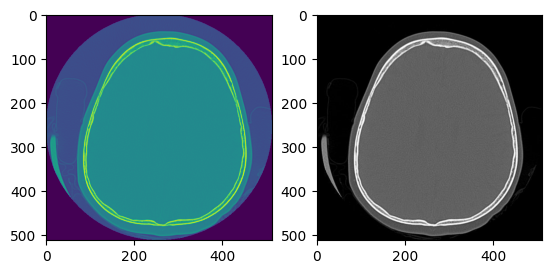

----FILE NAME tumor 51.jpg----


<Figure size 640x480 with 0 Axes>

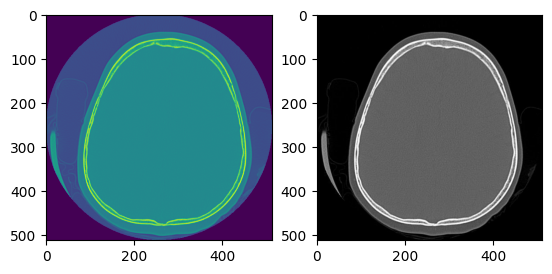

----FILE NAME tumor 52.jpg----


<Figure size 640x480 with 0 Axes>

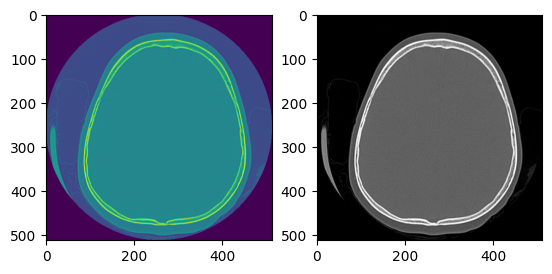

----FILE NAME tumor 53.jpg----


<Figure size 640x480 with 0 Axes>

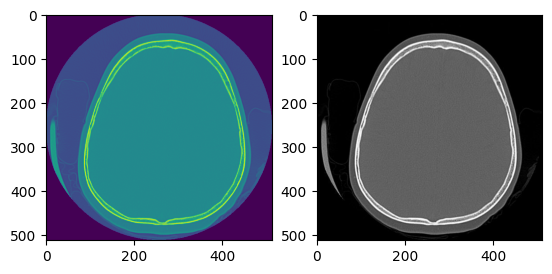

----FILE NAME tumor 54.jpg----


<Figure size 640x480 with 0 Axes>

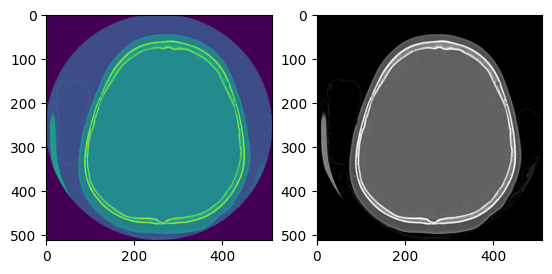

----FILE NAME tumor 55.jpg----


<Figure size 640x480 with 0 Axes>

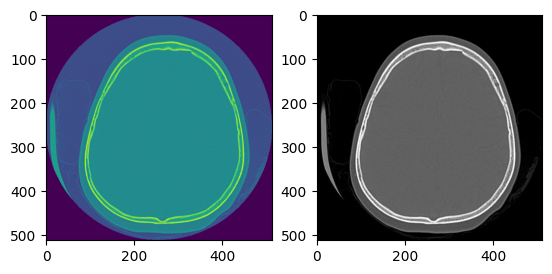

----FILE NAME tumor 56.jpg----


<Figure size 640x480 with 0 Axes>

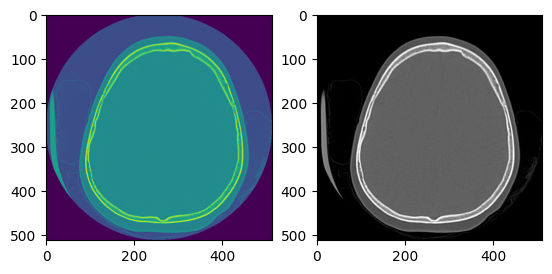

----FILE NAME tumor 57.jpg----


<Figure size 640x480 with 0 Axes>

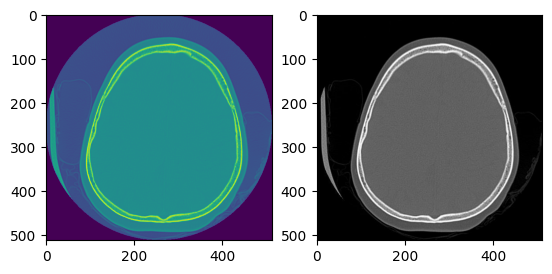

----FILE NAME tumor 58.jpg----


<Figure size 640x480 with 0 Axes>

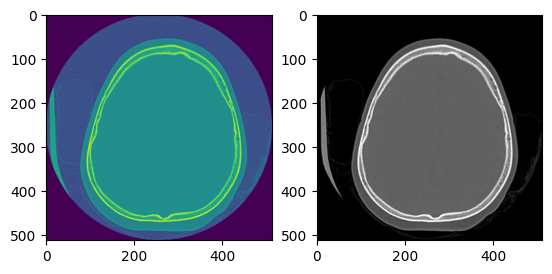

----FILE NAME tumor 59.jpg----


<Figure size 640x480 with 0 Axes>

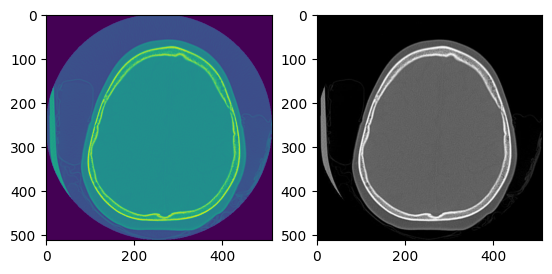

----FILE NAME tumor 60.jpg----


<Figure size 640x480 with 0 Axes>

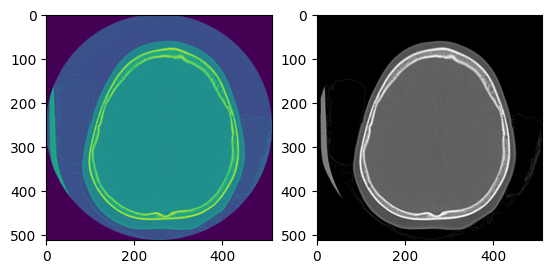

----FILE NAME tumor 61.jpg----


<Figure size 640x480 with 0 Axes>

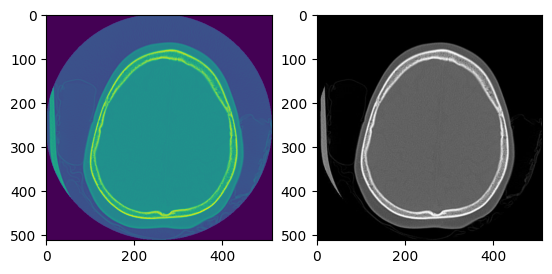

----FILE NAME tumor 62.jpg----


<Figure size 640x480 with 0 Axes>

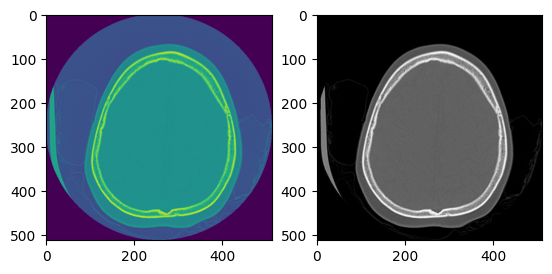

----FILE NAME tumor 63.jpg----


<Figure size 640x480 with 0 Axes>

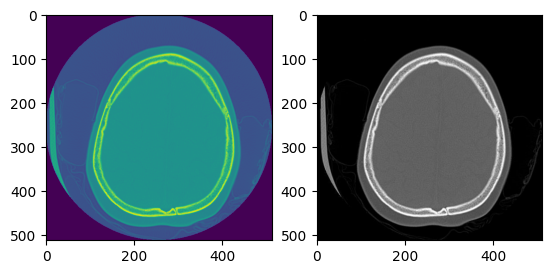

----FILE NAME tumor 64.jpg----


<Figure size 640x480 with 0 Axes>

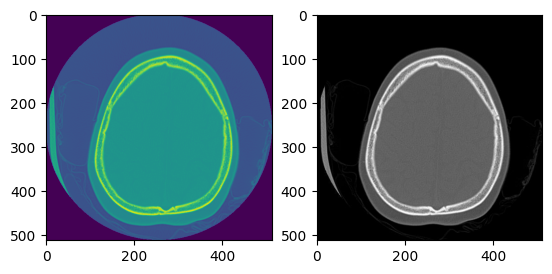

----FILE NAME tumor 65.jpg----


<Figure size 640x480 with 0 Axes>

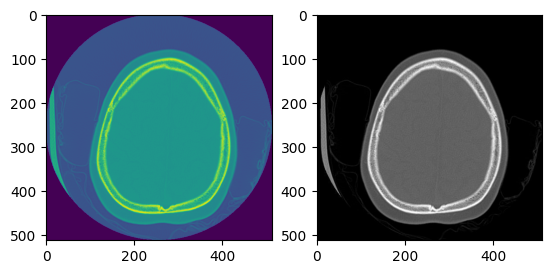

----FILE NAME tumor 66.jpg----


<Figure size 640x480 with 0 Axes>

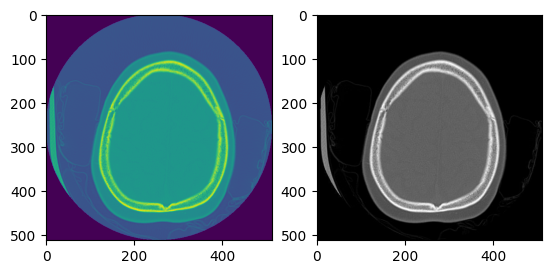

----FILE NAME tumor 67.jpg----


<Figure size 640x480 with 0 Axes>

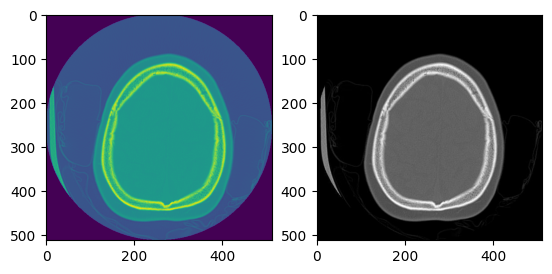

----FILE NAME tumor 68.jpg----


<Figure size 640x480 with 0 Axes>

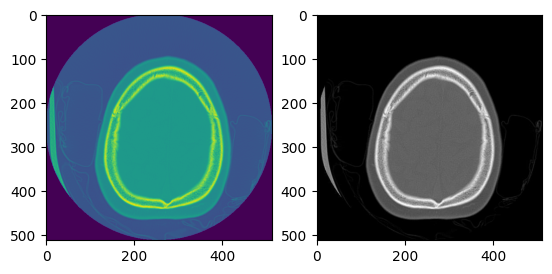

----FILE NAME tumor 69.jpg----


<Figure size 640x480 with 0 Axes>

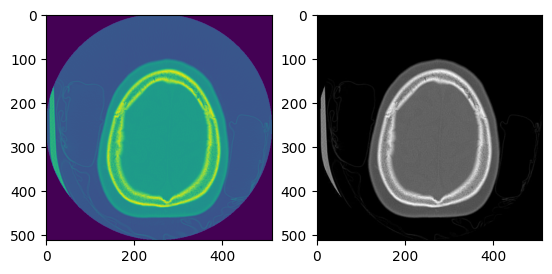

----FILE NAME tumor 70.jpg----


<Figure size 640x480 with 0 Axes>

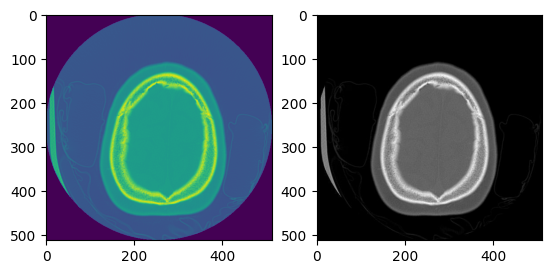

----FILE NAME tumor 71.jpg----


<Figure size 640x480 with 0 Axes>

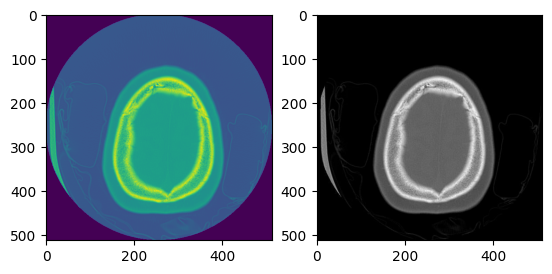

----FILE NAME tumor 72.jpg----


<Figure size 640x480 with 0 Axes>

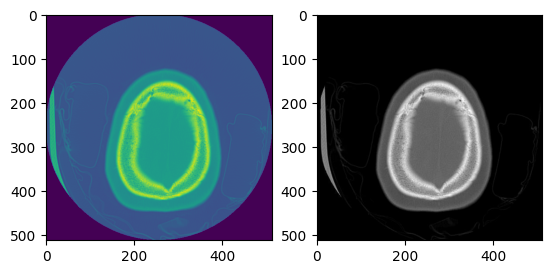

----FILE NAME tumor 73.jpg----


<Figure size 640x480 with 0 Axes>

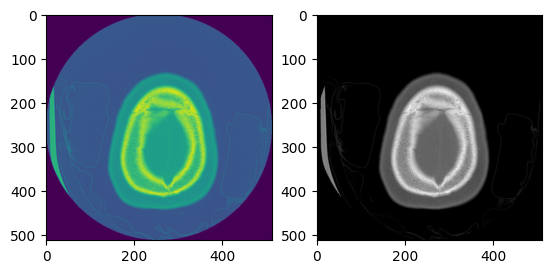

----FILE NAME tumor 74.jpg----


<Figure size 640x480 with 0 Axes>

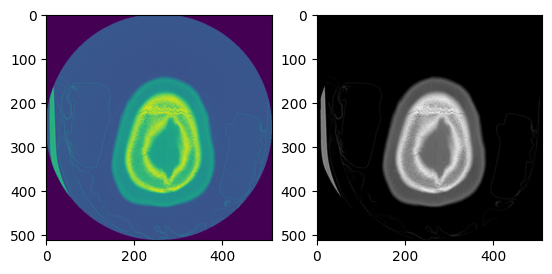

----FILE NAME tumor 75.jpg----


<Figure size 640x480 with 0 Axes>

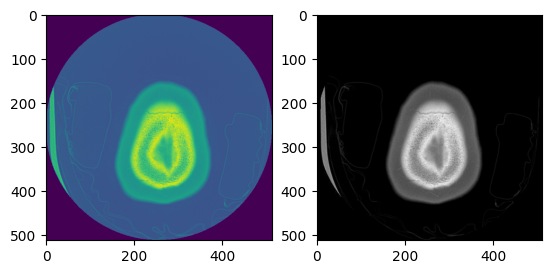

----FILE NAME tumor 76.jpg----


<Figure size 640x480 with 0 Axes>

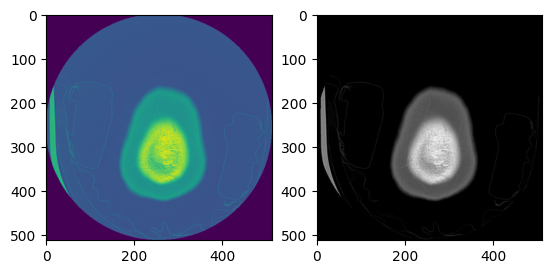

----FILE NAME tumor 77.jpg----


<Figure size 640x480 with 0 Axes>

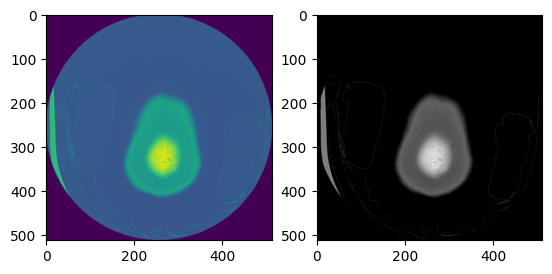

----FILE NAME tumor 78.jpg----


<Figure size 640x480 with 0 Axes>

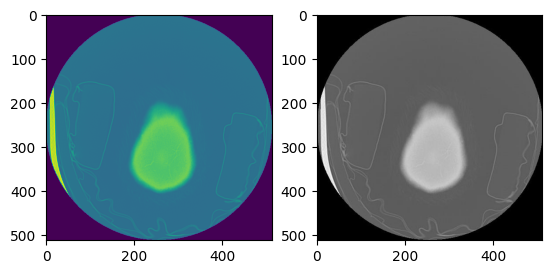

----FILE NAME tumor 79.jpg----


<Figure size 640x480 with 0 Axes>

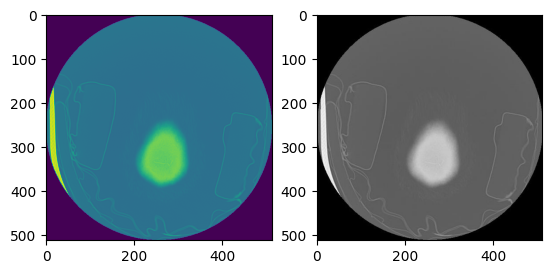

----FILE NAME tumor 80.jpg----


<Figure size 640x480 with 0 Axes>

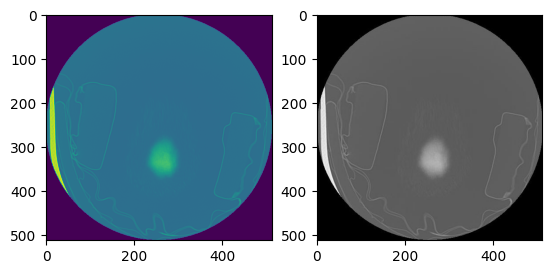

----FILE NAME tumor 81.jpg----


<Figure size 640x480 with 0 Axes>

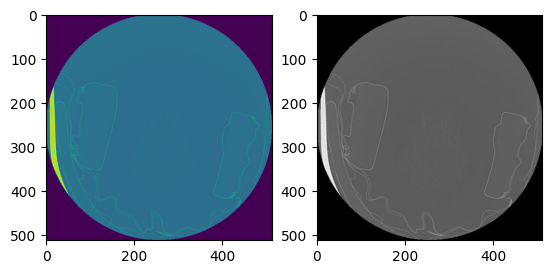

----FILE NAME tumor 82.jpg----


<Figure size 640x480 with 0 Axes>

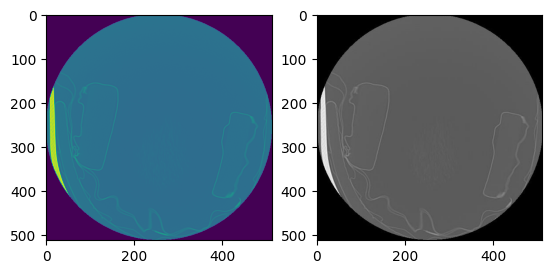

----FILE NAME tumor 83.jpg----


<Figure size 640x480 with 0 Axes>

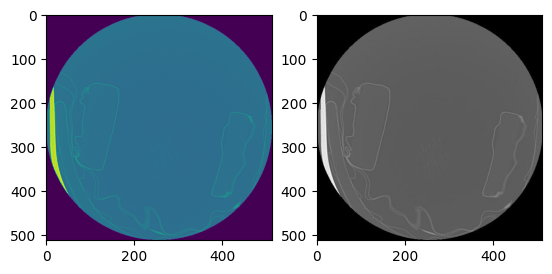

----FILE NAME cancer 0.jpg----


<Figure size 640x480 with 0 Axes>

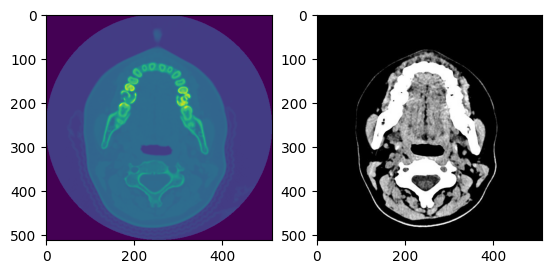

----FILE NAME cancer 1.jpg----


<Figure size 640x480 with 0 Axes>

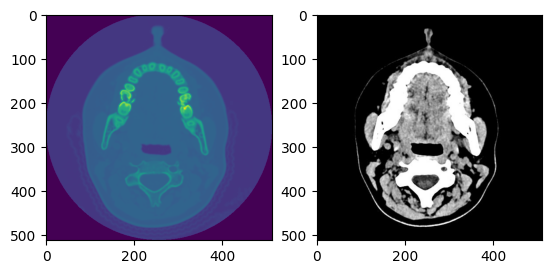

----FILE NAME cancer 2.jpg----


<Figure size 640x480 with 0 Axes>

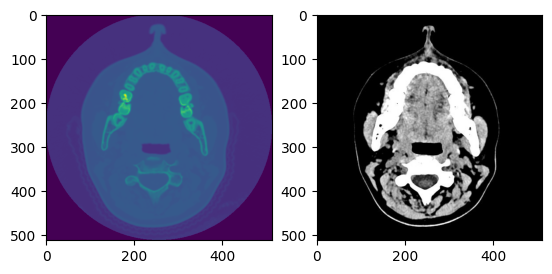

----FILE NAME cancer 3.jpg----


<Figure size 640x480 with 0 Axes>

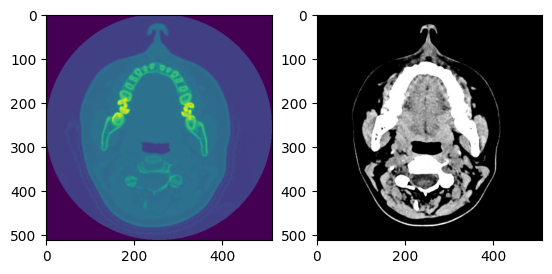

----FILE NAME cancer 4.jpg----


<Figure size 640x480 with 0 Axes>

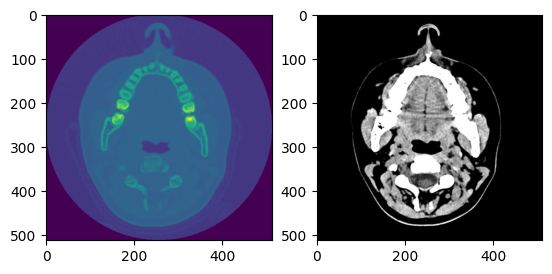

----FILE NAME cancer 5.jpg----


<Figure size 640x480 with 0 Axes>

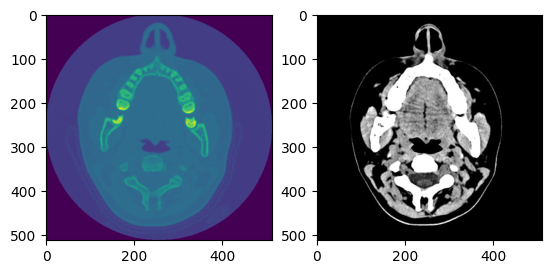

----FILE NAME cancer 6.jpg----


<Figure size 640x480 with 0 Axes>

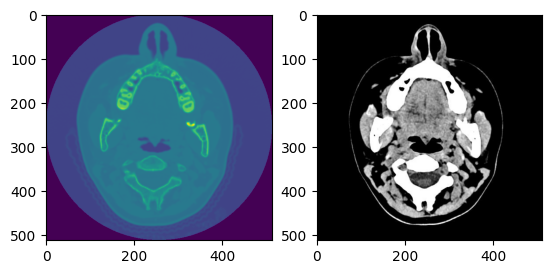

----FILE NAME cancer 7.jpg----


<Figure size 640x480 with 0 Axes>

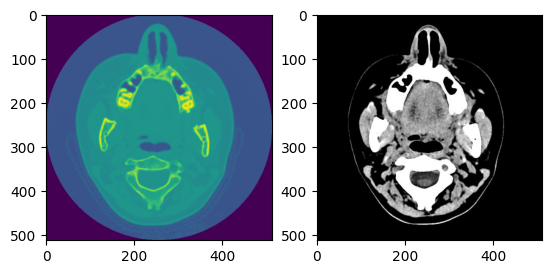

----FILE NAME cancer 8.jpg----


<Figure size 640x480 with 0 Axes>

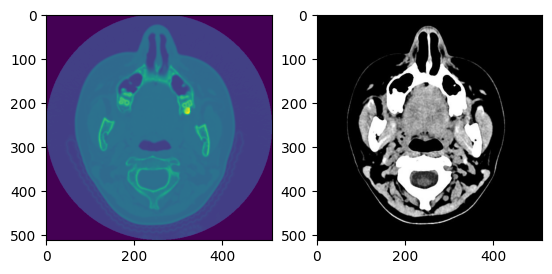

----FILE NAME cancer 9.jpg----


<Figure size 640x480 with 0 Axes>

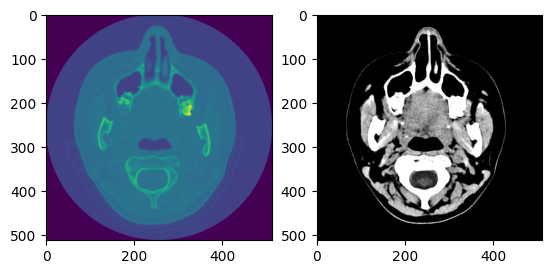

----FILE NAME cancer 10.jpg----


<Figure size 640x480 with 0 Axes>

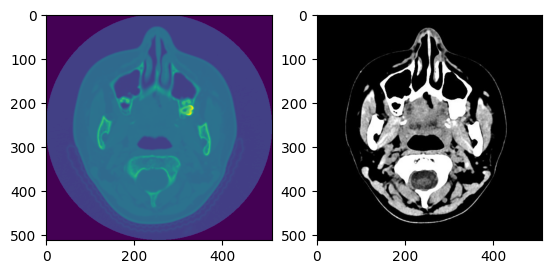

----FILE NAME cancer 11.jpg----


<Figure size 640x480 with 0 Axes>

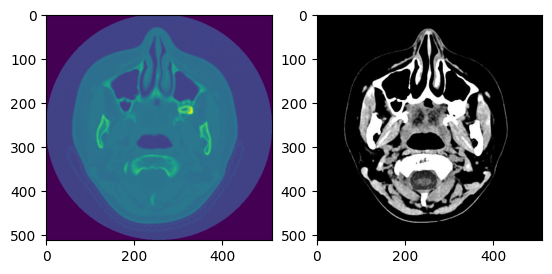

----FILE NAME cancer 12.jpg----


<Figure size 640x480 with 0 Axes>

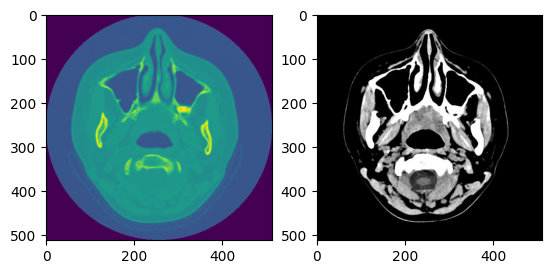

----FILE NAME cancer 13.jpg----


<Figure size 640x480 with 0 Axes>

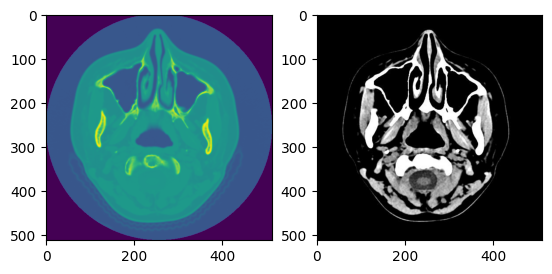

----FILE NAME cancer 14.jpg----


<Figure size 640x480 with 0 Axes>

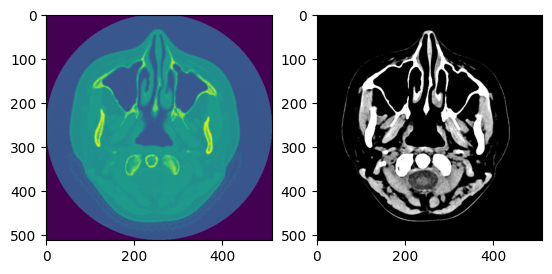

----FILE NAME cancer 15.jpg----


<Figure size 640x480 with 0 Axes>

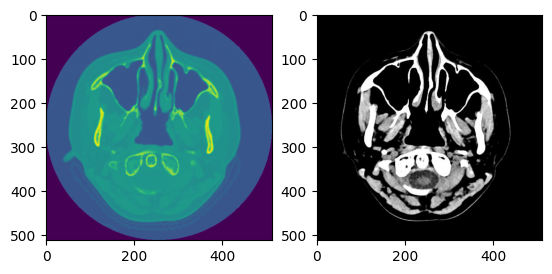

----FILE NAME cancer 16.jpg----


<Figure size 640x480 with 0 Axes>

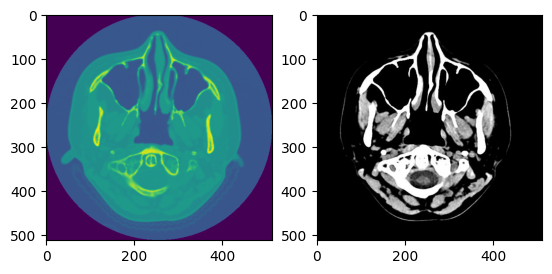

----FILE NAME cancer 17.jpg----


<Figure size 640x480 with 0 Axes>

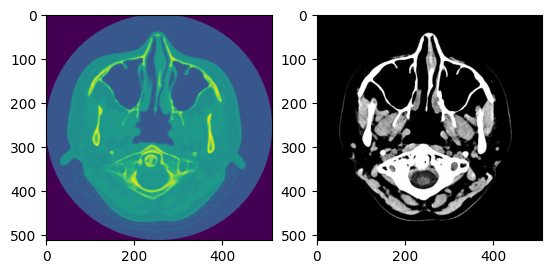

----FILE NAME cancer 18.jpg----


<Figure size 640x480 with 0 Axes>

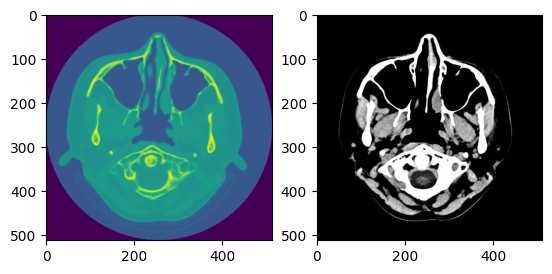

----FILE NAME cancer 20.jpg----


<Figure size 640x480 with 0 Axes>

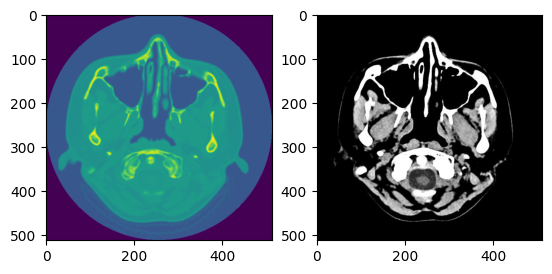

----FILE NAME cancer 21.jpg----


<Figure size 640x480 with 0 Axes>

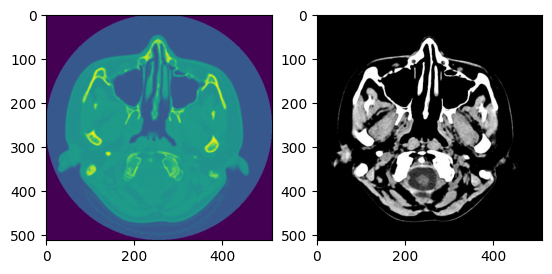

----FILE NAME cancer 22.jpg----


<Figure size 640x480 with 0 Axes>

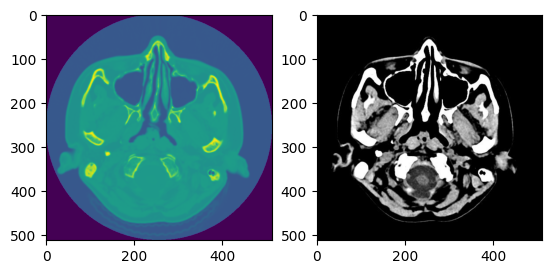

----FILE NAME cancer 23.jpg----


<Figure size 640x480 with 0 Axes>

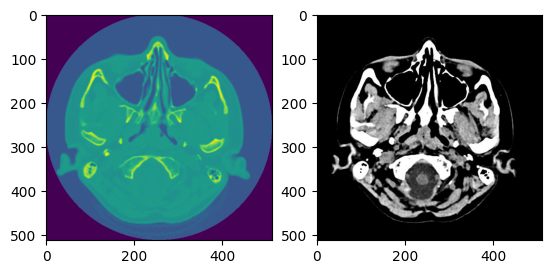

----FILE NAME cancer 24.jpg----


<Figure size 640x480 with 0 Axes>

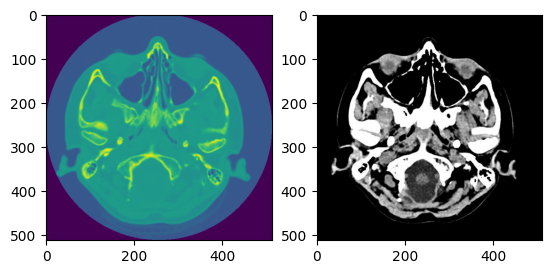

----FILE NAME cancer 25.jpg----


<Figure size 640x480 with 0 Axes>

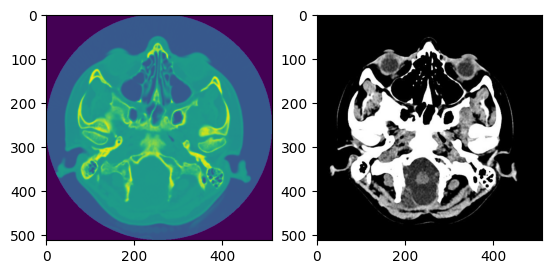

----FILE NAME cancer 26.jpg----


<Figure size 640x480 with 0 Axes>

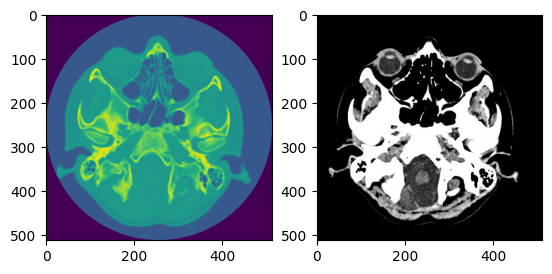

----FILE NAME cancer 27.jpg----


<Figure size 640x480 with 0 Axes>

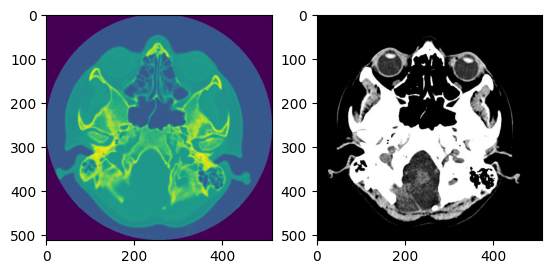

----FILE NAME cancer 28.jpg----


<Figure size 640x480 with 0 Axes>

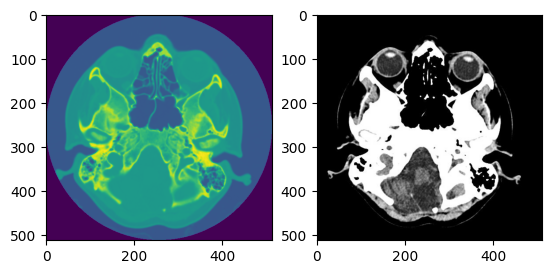

----FILE NAME cancer 29.jpg----


<Figure size 640x480 with 0 Axes>

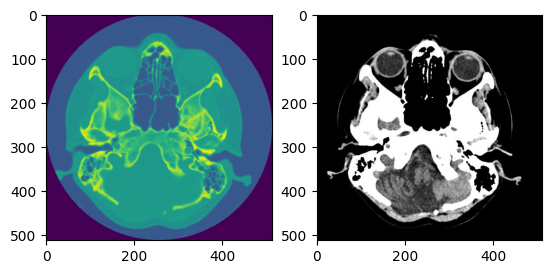

----FILE NAME cancer 30.jpg----


<Figure size 640x480 with 0 Axes>

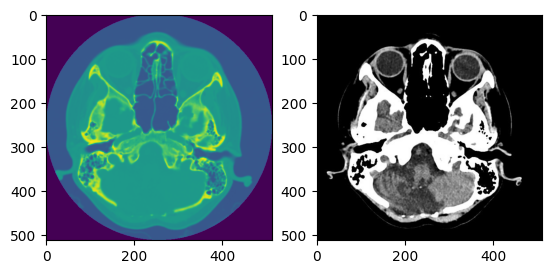

----FILE NAME cancer 31.jpg----


<Figure size 640x480 with 0 Axes>

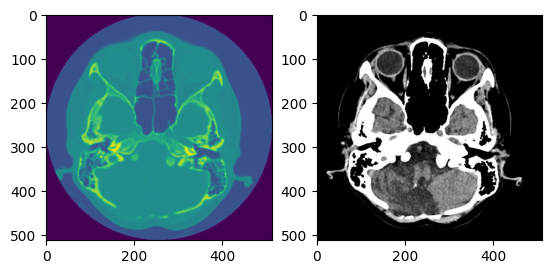

----FILE NAME cancer 32.jpg----


<Figure size 640x480 with 0 Axes>

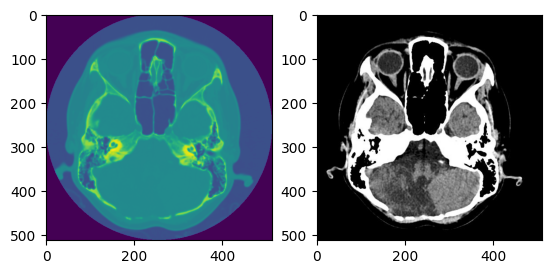

----FILE NAME cancer 33.jpg----


<Figure size 640x480 with 0 Axes>

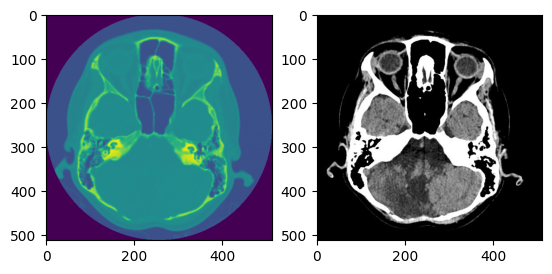

----FILE NAME cancer 34.jpg----


<Figure size 640x480 with 0 Axes>

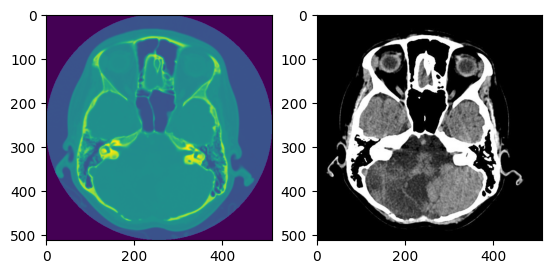

----FILE NAME cancer 35.jpg----


<Figure size 640x480 with 0 Axes>

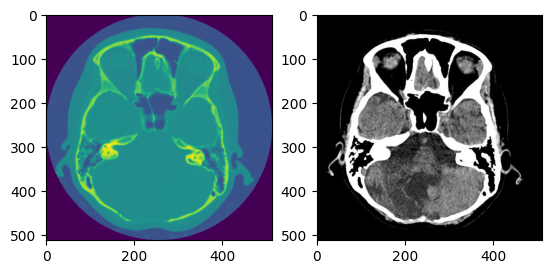

----FILE NAME cancer 36.jpg----


<Figure size 640x480 with 0 Axes>

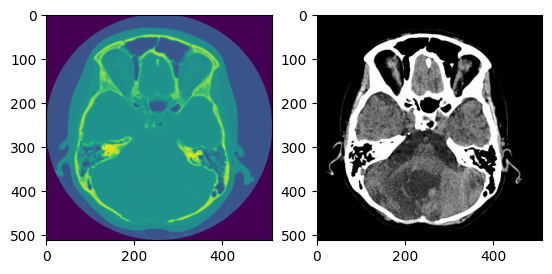

----FILE NAME cancer 37.jpg----


<Figure size 640x480 with 0 Axes>

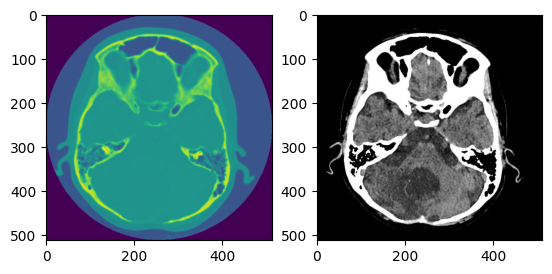

----FILE NAME cancer 38.jpg----


<Figure size 640x480 with 0 Axes>

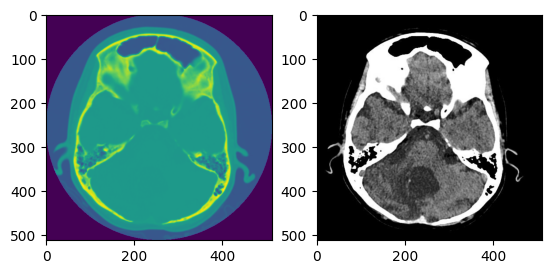

----FILE NAME cancer 39.jpg----


<Figure size 640x480 with 0 Axes>

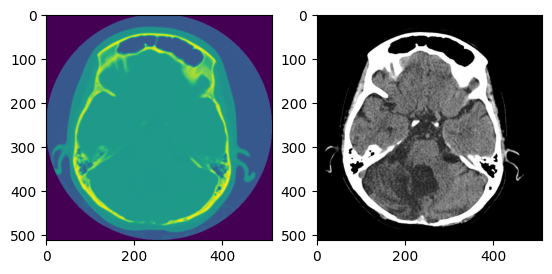

----FILE NAME cancer 40.jpg----


<Figure size 640x480 with 0 Axes>

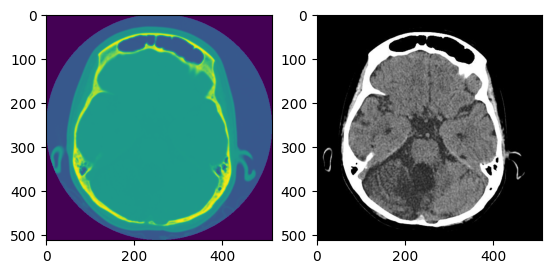

----FILE NAME cancer 41.jpg----


<Figure size 640x480 with 0 Axes>

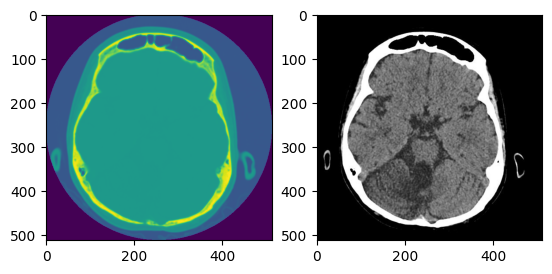

----FILE NAME cancer 42.jpg----


<Figure size 640x480 with 0 Axes>

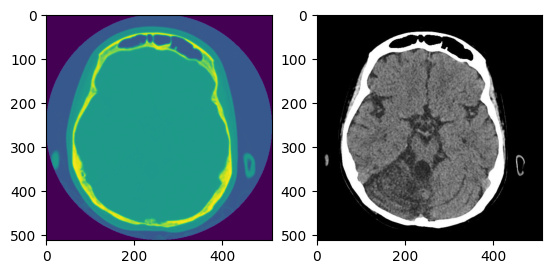

----FILE NAME cancer 43.jpg----


<Figure size 640x480 with 0 Axes>

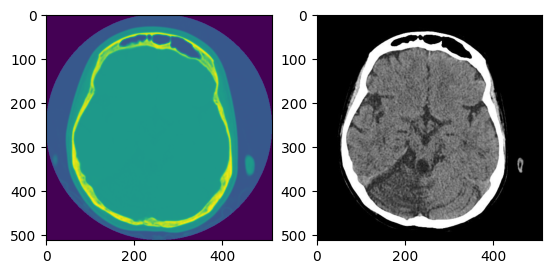

----FILE NAME cancer 44.jpg----


<Figure size 640x480 with 0 Axes>

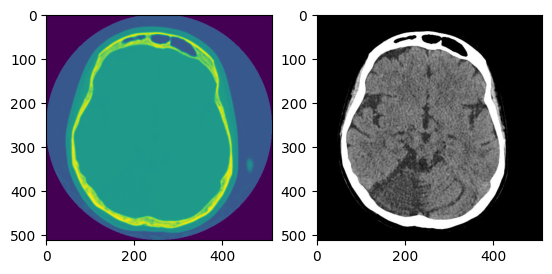

----FILE NAME cancer 45.jpg----


<Figure size 640x480 with 0 Axes>

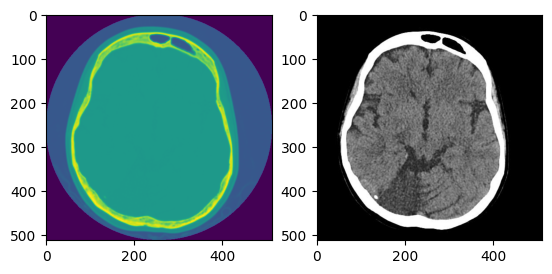

----FILE NAME cancer 46.jpg----


<Figure size 640x480 with 0 Axes>

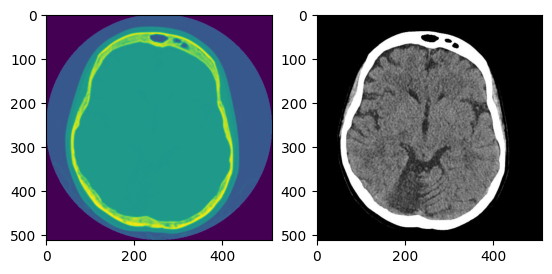

----FILE NAME cancer 47.jpg----


<Figure size 640x480 with 0 Axes>

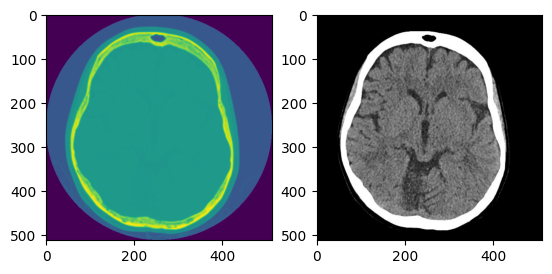

----FILE NAME cancer 48.jpg----


<Figure size 640x480 with 0 Axes>

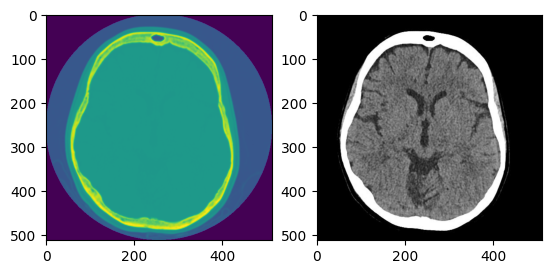

----FILE NAME cancer 49.jpg----


<Figure size 640x480 with 0 Axes>

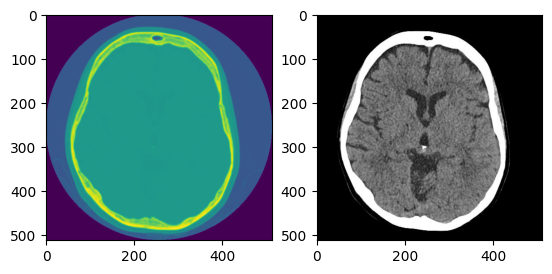

----FILE NAME cancer 50.jpg----


<Figure size 640x480 with 0 Axes>

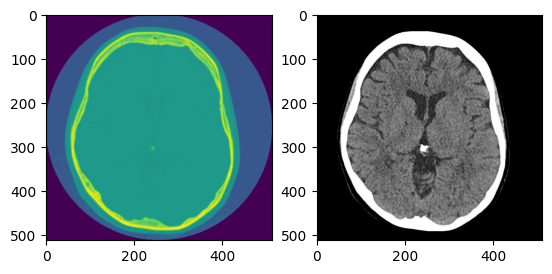

----FILE NAME cancer 51.jpg----


<Figure size 640x480 with 0 Axes>

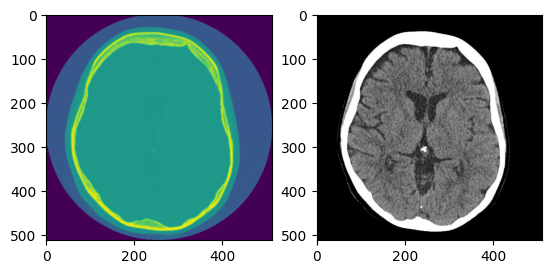

----FILE NAME cancer 52.jpg----


<Figure size 640x480 with 0 Axes>

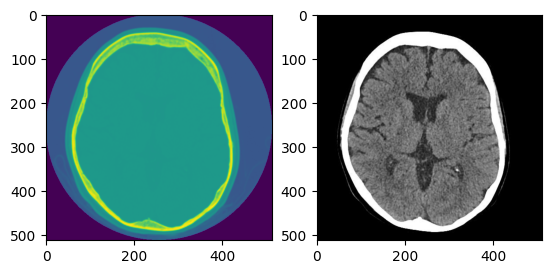

----FILE NAME cancer 53.jpg----


<Figure size 640x480 with 0 Axes>

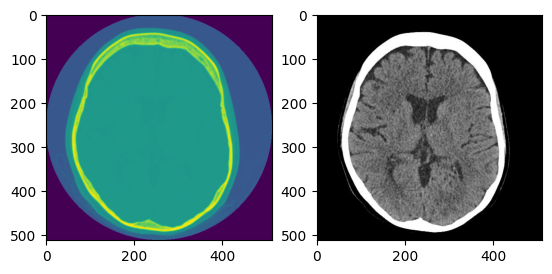

----FILE NAME cancer 54.jpg----


<Figure size 640x480 with 0 Axes>

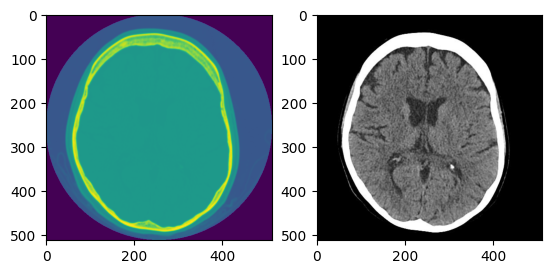

----FILE NAME cancer 55.jpg----


<Figure size 640x480 with 0 Axes>

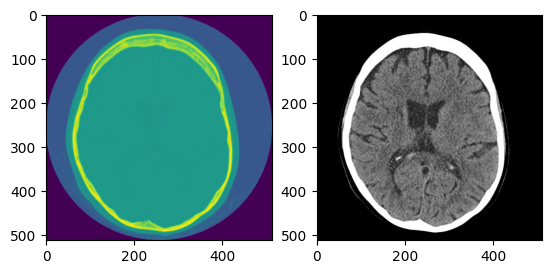

----FILE NAME cancer 56.jpg----


<Figure size 640x480 with 0 Axes>

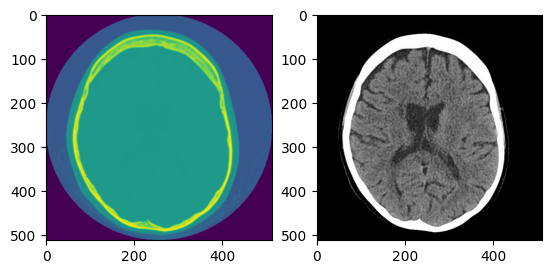

----FILE NAME cancer 57.jpg----


<Figure size 640x480 with 0 Axes>

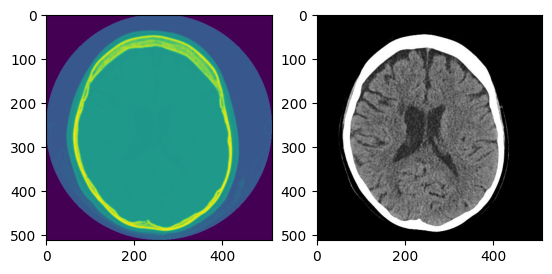

----FILE NAME cancer 58.jpg----


<Figure size 640x480 with 0 Axes>

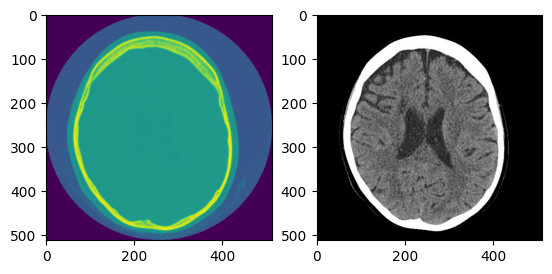

----FILE NAME cancer 59.jpg----


<Figure size 640x480 with 0 Axes>

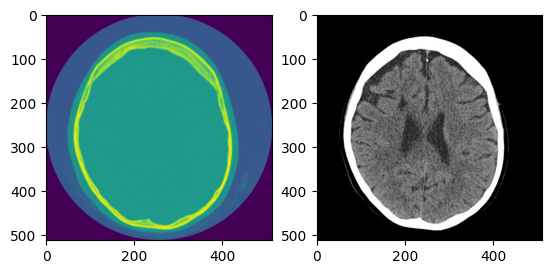

----FILE NAME cancer 60.jpg----


<Figure size 640x480 with 0 Axes>

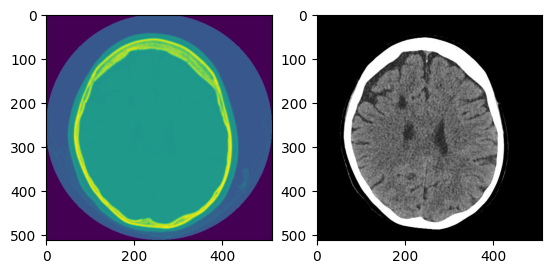

----FILE NAME cancer 61.jpg----


<Figure size 640x480 with 0 Axes>

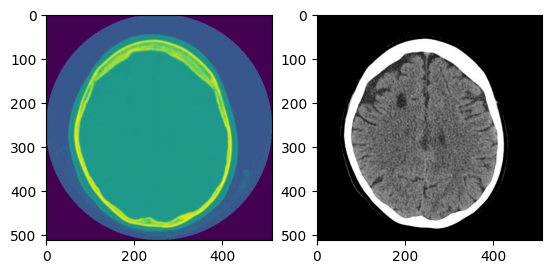

----FILE NAME cancer 62.jpg----


<Figure size 640x480 with 0 Axes>

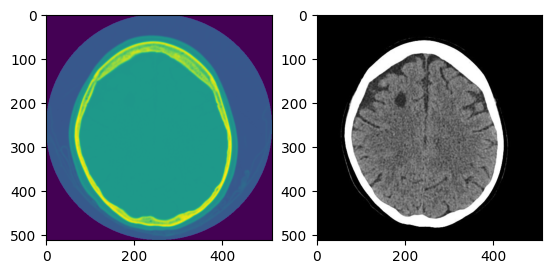

----FILE NAME cancer 63.jpg----


<Figure size 640x480 with 0 Axes>

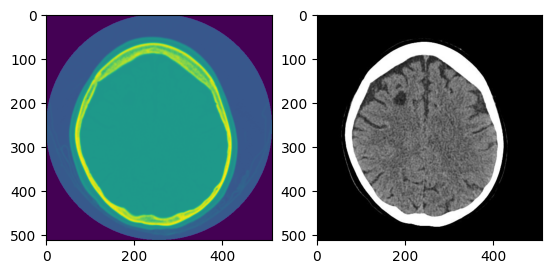

----FILE NAME cancer 64.jpg----


<Figure size 640x480 with 0 Axes>

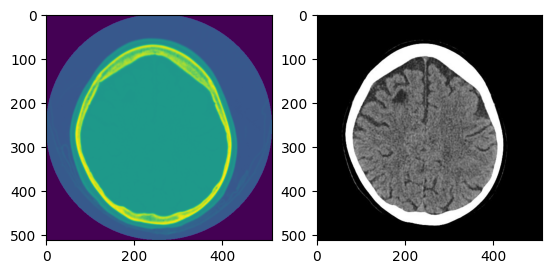

----FILE NAME cancer 65.jpg----


<Figure size 640x480 with 0 Axes>

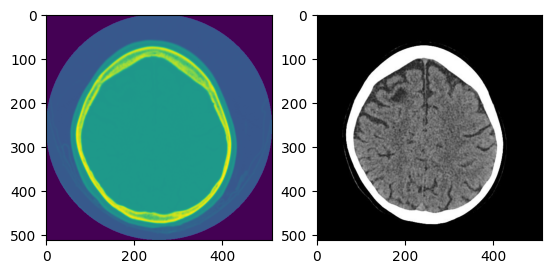

----FILE NAME cancer 66.jpg----


<Figure size 640x480 with 0 Axes>

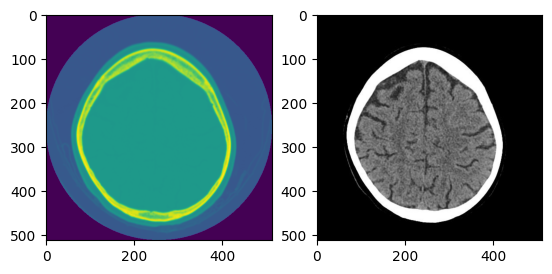

----FILE NAME cancer 67.jpg----


<Figure size 640x480 with 0 Axes>

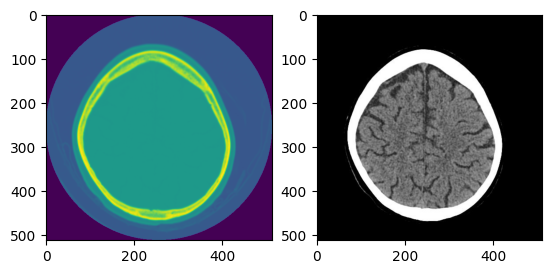

----FILE NAME cancer 68.jpg----


<Figure size 640x480 with 0 Axes>

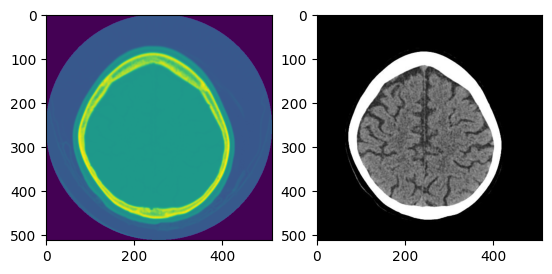

----FILE NAME cancer 69.jpg----


<Figure size 640x480 with 0 Axes>

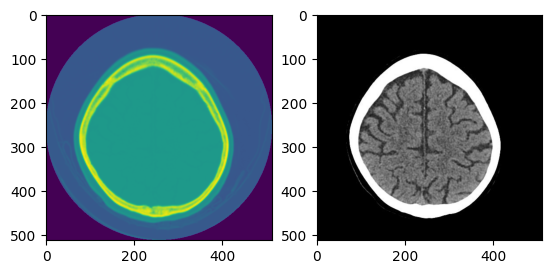

----FILE NAME cancer 70.jpg----


<Figure size 640x480 with 0 Axes>

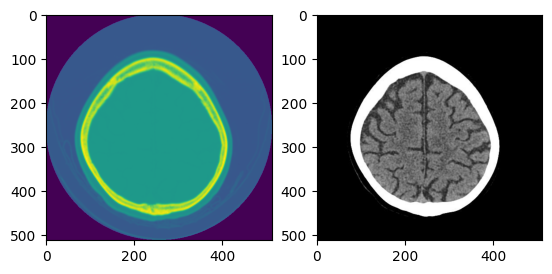

----FILE NAME cancer 71.jpg----


<Figure size 640x480 with 0 Axes>

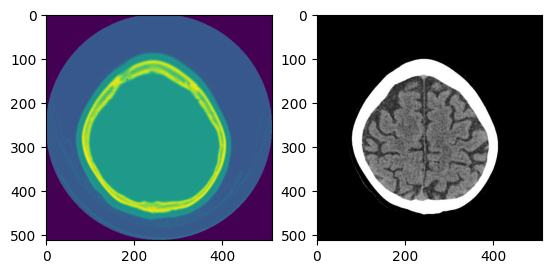

----FILE NAME cancer 72.jpg----


<Figure size 640x480 with 0 Axes>

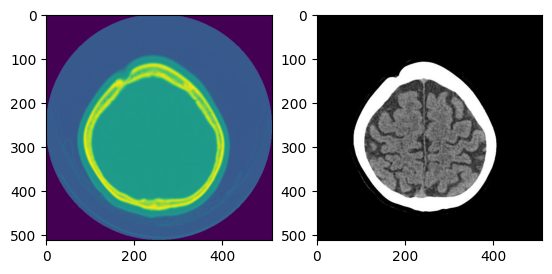

----FILE NAME cancer 73.jpg----


<Figure size 640x480 with 0 Axes>

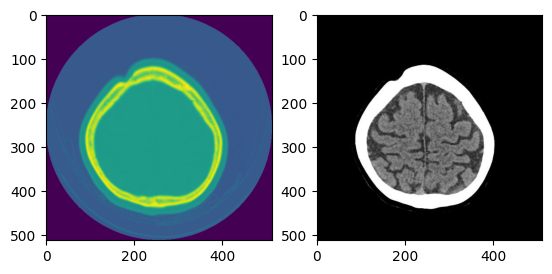

----FILE NAME cancer 74.jpg----


<Figure size 640x480 with 0 Axes>

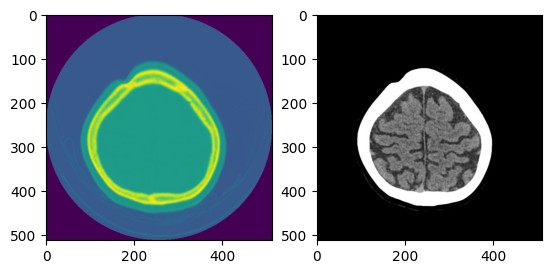

----FILE NAME cancer 75.jpg----


<Figure size 640x480 with 0 Axes>

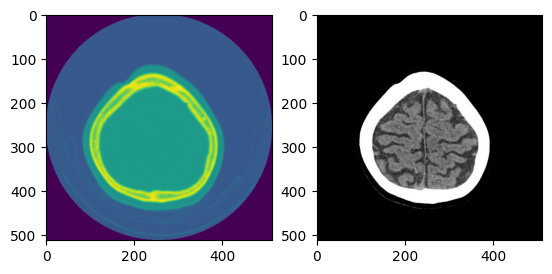

----FILE NAME cancer 76.jpg----


<Figure size 640x480 with 0 Axes>

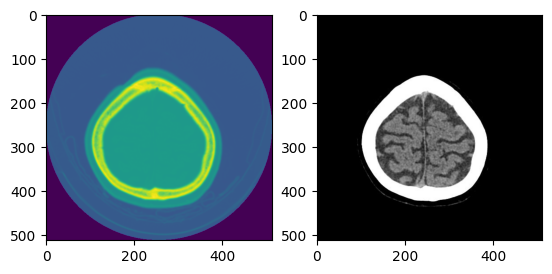

----FILE NAME cancer 77.jpg----


<Figure size 640x480 with 0 Axes>

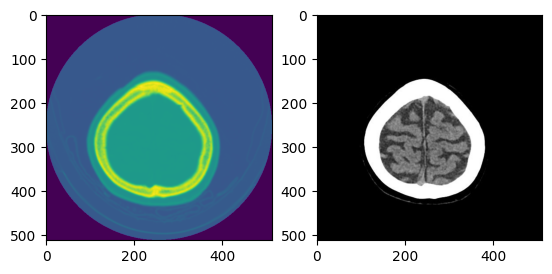

----FILE NAME cancer 78.jpg----


<Figure size 640x480 with 0 Axes>

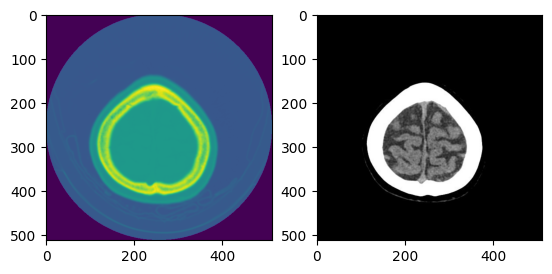

----FILE NAME cancer 79.jpg----


<Figure size 640x480 with 0 Axes>

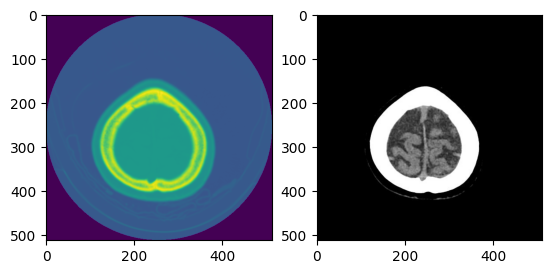

----FILE NAME cancer 80.jpg----


<Figure size 640x480 with 0 Axes>

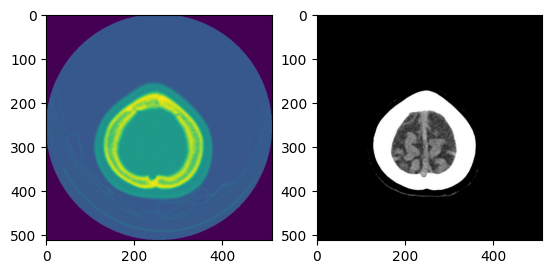

----FILE NAME cancer 81.jpg----


<Figure size 640x480 with 0 Axes>

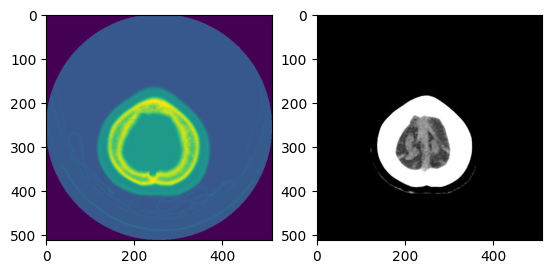

----FILE NAME cancer 82.jpg----


<Figure size 640x480 with 0 Axes>

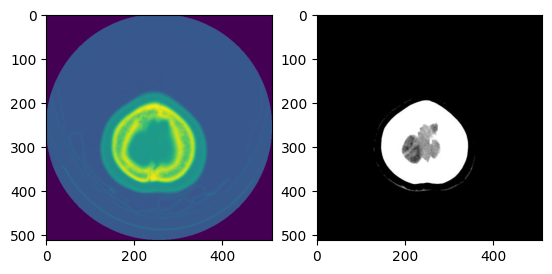

----FILE NAME cancer 83.jpg----


<Figure size 640x480 with 0 Axes>

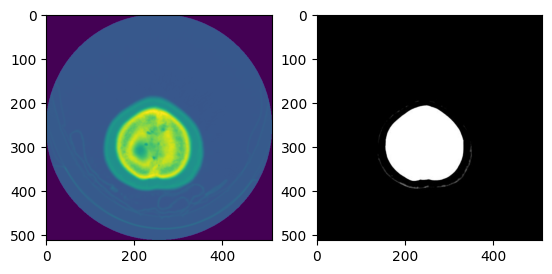

----FILE NAME cancer 84.jpg----


<Figure size 640x480 with 0 Axes>

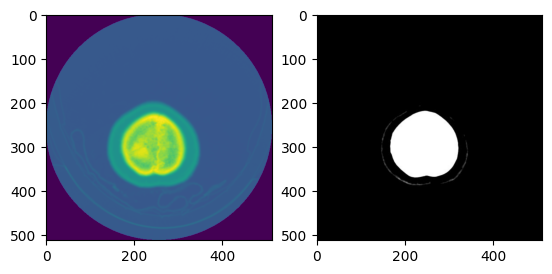

----FILE NAME cancer 85.jpg----


<Figure size 640x480 with 0 Axes>

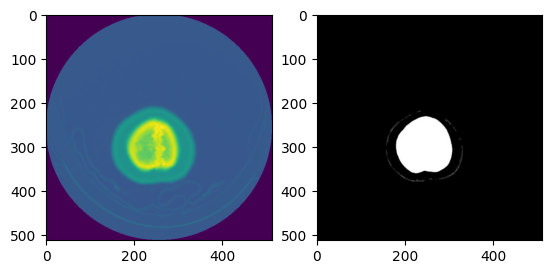

----FILE NAME cancer 86.jpg----


<Figure size 640x480 with 0 Axes>

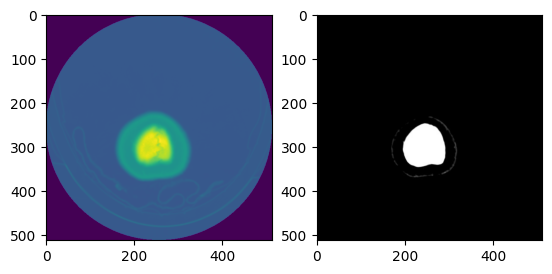

----FILE NAME cancer 87.jpg----


<Figure size 640x480 with 0 Axes>

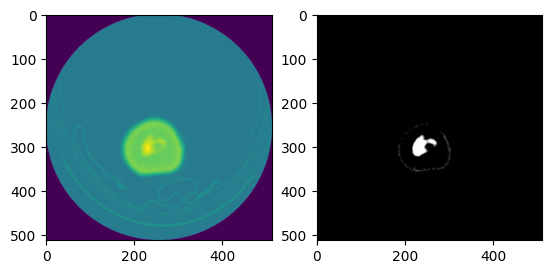

----FILE NAME cancer 88.jpg----


<Figure size 640x480 with 0 Axes>

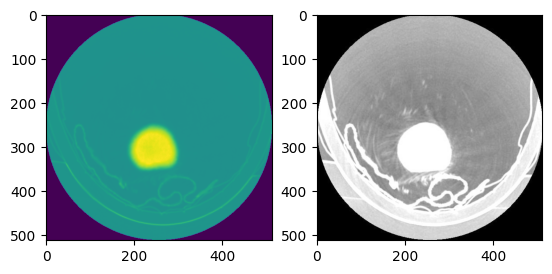

----FILE NAME cancer 89.jpg----


<Figure size 640x480 with 0 Axes>

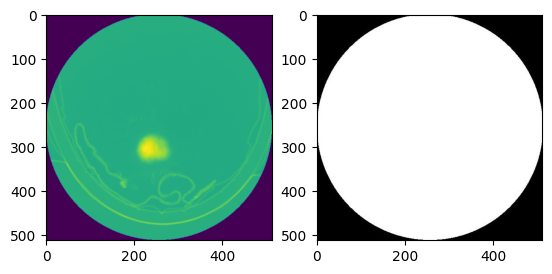

----FILE NAME cancer 90.jpg----


<Figure size 640x480 with 0 Axes>

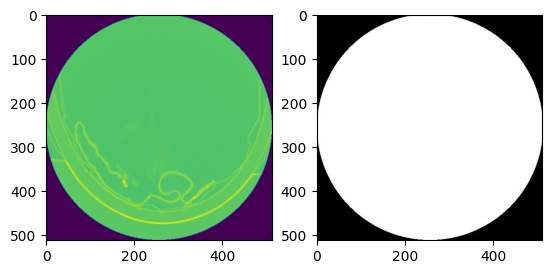

In [ ]:
for x in range(len(data)):
  fig = plt.figure()
  f, axarr = plt.subplots(1, 2)
  print(f"----FILE NAME {' '.join([a for a in data.loc[x, 'jpg'].split('/')[1:]])}----")
  file_jpg_path =  inital_file_path + 'files' + data.loc[x, 'jpg']
  file_dcm_path = inital_file_path + 'files' + data.loc[x, 'dcm']

    # Add the figure to the first subplot
  axarr[0].imshow(dicom.dcmread(file_dcm_path).pixel_array)

  # Add the image to the second subplot
  axarr[1].imshow(Image.open(file_jpg_path))
  plt.show()

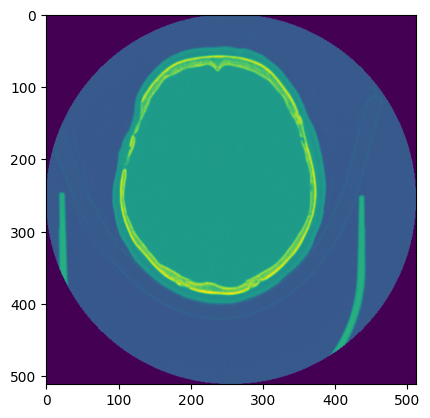

In [ ]:
# saving dcm figure to see whether there is tangible difference?
plt.imshow(dicom.dcmread(file_dcm_path).pixel_array)
plt.savefig(inital_file_path+'updated_figure.jpg')
plt.show()

## converting DCM files to JPG to highlight features better

In [ ]:
def convert_dcm_to_jpg(dcm_path, jpg_path):
    # Read DICOM file
    dicom_data = dicom.dcmread(dcm_path)

    # Convert pixel data to numpy array
    pixel_array = dicom_data.pixel_array

    # Convert to 8-bit unsigned integer (0-255)
    image_array = pixel_array.astype('uint8')

    # Create PIL Image
    image = Image.fromarray(image_array)

    # Save as JPEG
    image.save(jpg_path)
    return image_array



In [ ]:
processed_data

,dcm,jpg,aneurysm,cancer,tumor
0,/aneurysm/0.dcm,aneurysm/0.jpg,1,0,0
1,/aneurysm/1.dcm,aneurysm/1.jpg,1,0,0
2,/aneurysm/2.dcm,aneurysm/2.jpg,1,0,0
3,/aneurysm/3.dcm,aneurysm/3.jpg,1,0,0
4,/aneurysm/4.dcm,aneurysm/4.jpg,1,0,0
...,...,...,...,...,...
251,/cancer/86.dcm,cancer/86.jpg,0,1,0
252,/cancer/87.dcm,cancer/87.jpg,0,1,0
253,/cancer/88.dcm,cancer/88.jpg,0,1,0
254,/cancer/89.dcm,cancer/89.jpg,0,1,0


In [ ]:
for x in range(len(data)):

  image_name = inital_file_path + 'files' + data.loc[x, 'dcm']
  jpg_file_path = inital_file_path + 'updated_files/' + data.loc[x, 'jpg']
  info = convert_dcm_to_jpg(image_name, jpg_file_path)
  break

drive/MyDrive/ai_assessment/files/aneurysm/0.dcm


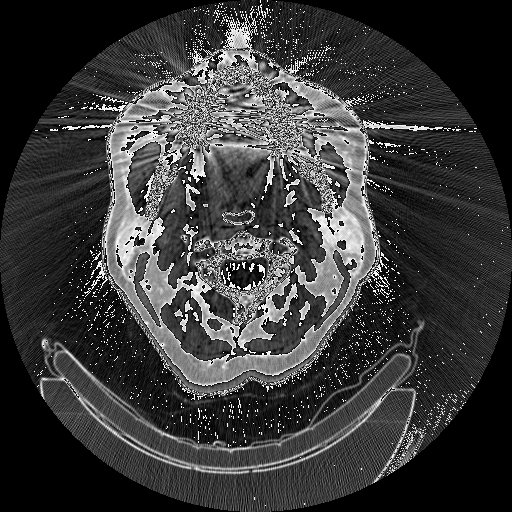

In [ ]:
# sample image of aneurysm after converting dcm -> jpg rather than using the native jpg
#
Image.fromarray(info)

When comparing images of the anueyrysm it is clear by converting DCM -> JPG it reveals more features within the image rather that using the native JPG image.

There seems to be alot more detail within the image which the model can potentially learn from.This how to the same image file looked originally in the JPG format

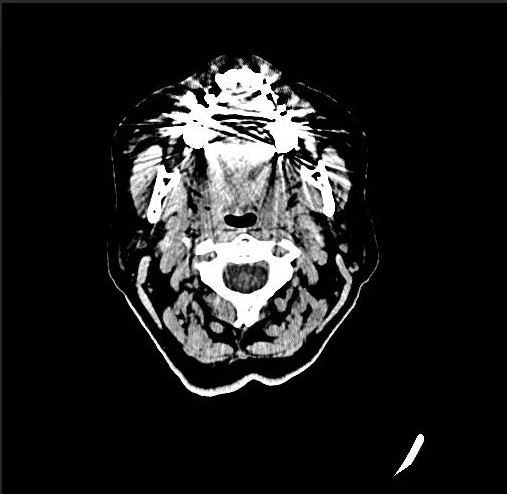

## references
(1) - Lin, T.Y., Goyal, P., Girshick, R., He, K. and Dollár, P., 2017. Focal loss for dense object detection. In Proceedings of the IEEE international conference on computer vision (pp. 2980-2988).